In [2]:
################################## IMPORTING  LIBRARIES ##############################################
import sys
import time
import cv2
import numpy as np
from matplotlib import pyplot as plt
import tensorflow as tf
import os
import zipfile
import tensorflow as tf
from skimage.transform import resize
from sklearn.model_selection import train_test_split

from tensorflow.python.keras.utils import np_utils
from tensorflow.python.keras.models import Sequential, Model
from tensorflow.python.keras.layers import Dense, Dropout, Flatten, Activation, BatchNormalization
from tensorflow.python.keras.layers.convolutional import Conv2D, MaxPooling2D 
from tensorflow.python.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.optimizers import RMSprop
from tensorflow.python.keras.applications import VGG19, ResNet50
sys.version

'3.6.7 (default, Oct 22 2018, 11:32:17) \n[GCC 8.2.0]'

In [5]:
#getting all files path
base_path = '/flowerDataset/flower_photos/'
#categories for classification
categories = ['daisy', 'dandelion', 'roses', 'sunflowers', 'tulips']
#looping through all the folders and appending path to the list
fnames = []
for category in categories:
    flower_folder = os.path.join(base_path, category)
    file_names = os.listdir(flower_folder)
    full_path = [os.path.join(flower_folder, file_name) for file_name in file_names]
    fnames.append(full_path)
#printing length for 
print('length for each category:', [len(f) for f in fnames])

length for each category: [633, 898, 641, 699, 799]


In [6]:
#getting total nummber of images of each category
images = []
for names in fnames:
    one_category_images = [cv2.imread(name) for name in names if (cv2.imread(name)) is not None]
    images.append(one_category_images)

print('number of images for each category:', [len(f) for f in images])

number of images for each category: [633, 898, 641, 699, 799]


In [7]:
#getting minimum dimension of each category
for i,imgs in enumerate(images):
    shapes = [img.shape for img in imgs]
    widths = [shape[0] for shape in shapes]
    heights = [shape[1] for shape in shapes]
    print('%d,%d is the min shape for %s' % (np.min(widths), np.min(heights), categories[i]))

180,158 is the min shape for daisy
211,146 is the min shape for dandelion
200,159 is the min shape for roses
180,152 is the min shape for sunflowers
159,143 is the min shape for tulips


/usr/local/lib/python3.6/dist-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


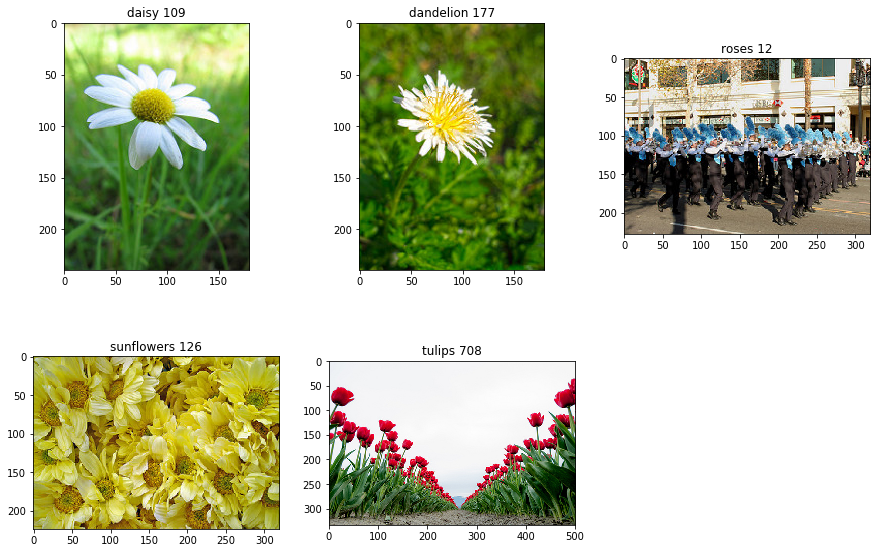

In [8]:
#function to convert imageto RGB using openCv
def cvtRGB(img):
    return cv2.cvtColor(img.copy(), cv2.COLOR_BGR2RGB)

#plotting image of each category
plt.figure(figsize=(15,10))
for i, imgs in enumerate(images):
    plt.subplot(2,3,i+1)
    idx = np.random.randint(len(imgs))
    plt.imshow(cvtRGB(imgs[idx]))
    plt.grid('off')
    plt.title(categories[i]+' '+str(idx))
plt.show()

(240, 320, 3)
(256, 256, 3)


/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


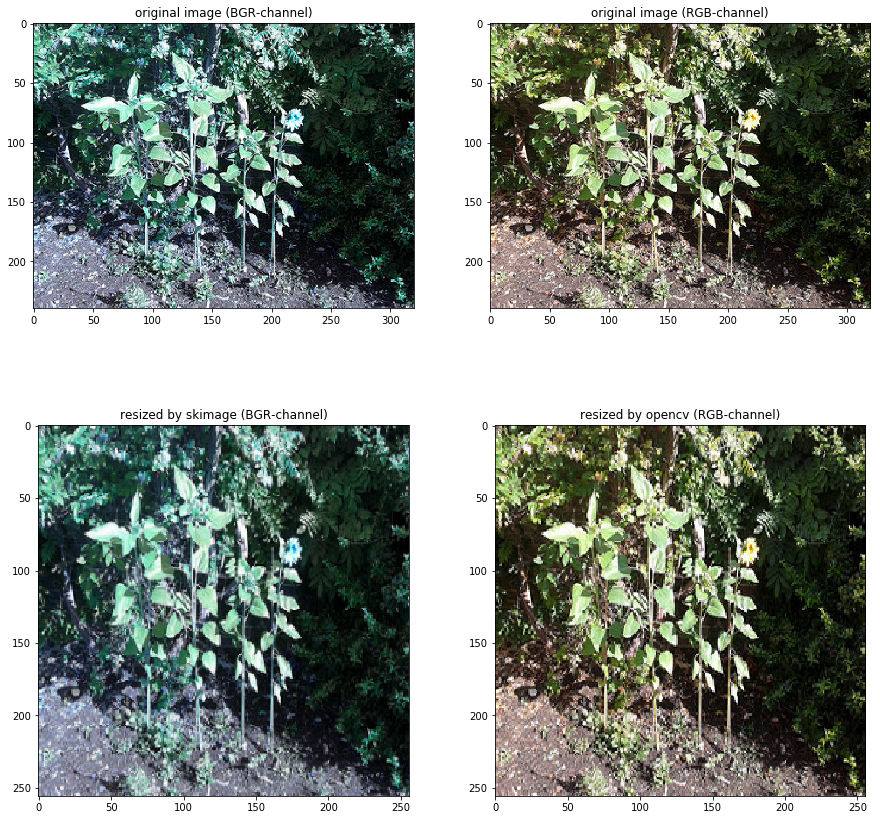

In [9]:
img_width, img_height = 256, 256
#plotting image in various channel format
img = images[3][659]
print(img.shape)
resized_img = resize(img, (img_width, img_height, 3))
resized_img2 = cv2.resize(img,(img_width, img_height), interpolation = cv2.INTER_CUBIC)
print(resized_img.shape)
plt.figure(figsize=(15,15))
plt.subplot(2,2,1)
plt.title('original image (BGR-channel)')
plt.grid(False)
plt.imshow(img)
plt.subplot(2,2,2)
plt.title('original image (RGB-channel)')
plt.grid(False)
plt.imshow(cvtRGB(img))
plt.subplot(2,2,3)
plt.title('resized by skimage (BGR-channel)')
plt.grid(False)
plt.imshow((resized_img))
plt.subplot(2,2,4)
plt.title('resized by opencv (RGB-channel)')
plt.grid(False)
plt.imshow(cvtRGB(resized_img2))
plt.show()

In [0]:
#resizing all images
resized_images = []
for i,imgs in enumerate(images):
    resized_images.append([cv2.resize(img, (img_width, img_height), interpolation = cv2.INTER_CUBIC) for img in imgs])
#splitting data into training and testing dataset (80% training, 20% testing)
train_images = []
val_images = []
for imgs in resized_images:
    train, test = train_test_split(imgs, train_size=0.8, test_size=0.2)
    train_images.append(train)
    val_images.append(test)

In [11]:
#reading the records of training and testing dataset for each categogry
len_train_images = [len(imgs) for imgs in train_images]
print(len_train_images)
print('sum of train images:', np.sum(len_train_images))
train_categories = np.zeros((np.sum(len_train_images)), dtype='uint8')
for i in range(5):
    if i is 0:
        train_categories[:len_train_images[i]] = i
    else:
        train_categories[np.sum(len_train_images[:i]):np.sum(len_train_images[:i+1])] = i
        
len_val_images = [len(imgs) for imgs in val_images]
print(len_val_images)
print('sum of val_images:', np.sum(len_val_images))
val_categories = np.zeros((np.sum(len_val_images)), dtype='uint8')
for i in range(5):
    if i is 0:
        val_categories[:len_val_images[i]] = i
    else:
        val_categories[np.sum(len_val_images[:i]):np.sum(len_val_images[:i+1])] = i

[506, 718, 512, 559, 639]
sum of train images: 2934
[127, 180, 129, 140, 160]
sum of val_images: 736


In [12]:
#converting to numpy arrays 
tmp_train_imgs = []
tmp_val_imgs = []
for imgs in train_images:
    tmp_train_imgs += imgs
for imgs in val_images:
    tmp_val_imgs += imgs
train_images = np.array(tmp_train_imgs)
val_images = np.array(tmp_val_imgs)

print('Before converting')
print('train data:', train_images.shape)
print('train labels:', train_categories.shape)
#converting labels category wise
train_data = train_images.astype('float32')
val_data = val_images.astype('float32')
train_labels = np_utils.to_categorical(train_categories, len(categories))
val_labels = np_utils.to_categorical(val_categories, len(categories))
print()
print('After converting')
print('train data:', train_data.shape)
print('train labels:', train_labels.shape)

Before converting
train data: (2934, 256, 256, 3)
train labels: (2934,)

After converting
train data: (2934, 256, 256, 3)
train labels: (2934, 5)


In [13]:
#shuffling the data
seed = 100
np.random.seed(seed)
np.random.shuffle(train_data)
np.random.seed(seed)
np.random.shuffle(train_labels)
np.random.seed(seed)
np.random.shuffle(val_data)
np.random.seed(seed)
np.random.shuffle(val_labels)
#splitting data into training and testing 
train_data = train_data[:3400]
train_labels = train_labels[:3400]
val_data = val_data[:860]
val_labels = val_labels[:860]
#checking dimension 
print('shape of train data:', train_data.shape)
print('shape of train labels:', train_labels.shape)
print('shape of val data:', val_data.shape)
print('shape of val labels:', val_labels.shape)

shape of train data: (2934, 256, 256, 3)
shape of train labels: (2934, 5)
shape of val data: (736, 256, 256, 3)
shape of val labels: (736, 5)


In [0]:
# Parameters
batch_size = 32
epochs1 = 20
epochs2 = 20
epochs3 = 20

# Data Augmenting by using ImageDataGenerator by rotating, flipping , zooming
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.4,
    height_shift_range=0.4,
    shear_range=0.2,
    zoom_range=0.3,
    horizontal_flip=True
)

# Only rescaling validation data. No augmentation required
val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,

)

# Flow function to use training images generated by generator in batches 
train_generator = train_datagen.flow(
    train_data,
    train_labels,
    batch_size=batch_size
)
# Flow function to use validation images generated by generator in batches 
val_generator = val_datagen.flow(
    val_data,
    val_labels,
    batch_size=batch_size
)

In [0]:
#################################### BUILDING MODEL FROM SCRATCH
def create_model_from_scratch():
    #creating basic model using Sequential
    model = tf.keras.models.Sequential()
    #first layer
    model.add(tf.keras.layers.Conv2D(32, (3,3), padding='same', input_shape=(256,256,3), 
                                     activation='relu', name='conv_1'))
    #adding max pooling with size 2,2
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), name='maxpool_1'))
    #second layer
    model.add(tf.keras.layers.Conv2D(64, (3,3), padding='same', activation='relu', name='conv_2'))
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), name='maxpool_2'))
    #third layer
    model.add(Conv2D(100, (3,3), padding='same', activation='relu', name='conv_3'))
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), name='maxpool_3'))
    #fourth layer
    model.add(Conv2D(100, (3,3), activation='relu', name='conv_4'))
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), name='maxpool_4'))
    #flattening layer
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(512,  name='dense_1',activation='relu'))
    #final output layer with softmax activation as it is multi classification for having 5 categories
    model.add(tf.keras.layers.Dense(len(categories), name='output',activation='softmax'))
    #compiling the model using adam as optimizer
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc']) # optimizer=RMSprop(lr=0.001)
    
    return model
#building the model  
model_scratch = create_model_from_scratch()
#printing model structure
model_scratch.summary()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv_1 (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
maxpool_1 (MaxPooling2D)     (None, 128, 128, 32)      0         
_________________________________________________________________
conv_2 (Conv2D)              (None, 128, 128, 64)      18496     
_________________________________________________________________
maxpool_2 (MaxPooling2D)     (None, 64, 64, 64)        0         
_________________________________________________________________
conv_3 (Conv2D)              (None, 64, 64, 100)       57700     
_________________________________________________________________
maxpool_3 (MaxPooling2D)     (None, 32, 32, 100)       0         
_________________________________________________________________
conv_4 (Conv2D)              (None, 30, 30, 100)       90100     
__________

In [0]:
#to calculate time taken for training
start = time.time()
#training the model using fir_generator and per steps batch wise imaged is feeded
model_scratch_history = model_scratch.fit_generator(
    generator=train_generator, 
    steps_per_epoch=len(train_data)/batch_size,  
    epochs=epochs1, 
    validation_steps=len(val_data)/batch_size, 
    validation_data=val_generator, 
    verbose=2
)
#printing time taken
end = time.time()
duration = end - start
print ('\n model_scratch took %0.2f seconds (%0.1f minutes) to train for %d epochs'%(duration, duration/60, epochs1) )

Epoch 1/20
23/23 [==============================] - 2s 79ms/step - loss: 1.4283 - acc: 0.3764
 - 49s - loss: 1.6115 - acc: 0.2532 - val_loss: 1.4283 - val_acc: 0.3764
Epoch 2/20
23/23 [==============================] - 2s 70ms/step - loss: 1.1179 - acc: 0.5448
 - 49s - loss: 1.2423 - acc: 0.4939 - val_loss: 1.1179 - val_acc: 0.5448
Epoch 3/20
23/23 [==============================] - 2s 69ms/step - loss: 0.9847 - acc: 0.6168
 - 49s - loss: 1.1306 - acc: 0.5498 - val_loss: 0.9847 - val_acc: 0.6168
Epoch 4/20
23/23 [==============================] - 2s 67ms/step - loss: 0.9502 - acc: 0.6291
 - 49s - loss: 1.0389 - acc: 0.5757 - val_loss: 0.9502 - val_acc: 0.6291
Epoch 5/20
23/23 [==============================] - 1s 64ms/step - loss: 0.8842 - acc: 0.6617
 - 49s - loss: 0.9584 - acc: 0.6169 - val_loss: 0.8842 - val_acc: 0.6617
Epoch 6/20
23/23 [==============================] - 2s 69ms/step - loss: 0.8657 - acc: 0.6617
 - 49s - loss: 0.9015 - acc: 0.6431 - val_loss: 0.8657 - val_acc: 0.661

## **Transfer Learning**

In [18]:
################### BUILDING TRANSFER MODEL USING VGG19 #########################
def create_model_Using_VGG19():
    #loading VGG19 model with pretrained weights from imagenet
    model = VGG19(weights = "imagenet", include_top=False, input_shape = (img_width, img_height, 3))
    #Additional layers 
    x = model.output
    x = Flatten()(x)
    x = Dense(256, activation="relu")(x)
    #using dropout layer
    x = Dropout(0.25)(x)
    #final output layer with softmax activation having class=5 for multi classification
    predictions = Dense(len(categories), activation="softmax")(x)
    
    # creating the final model by freezing top 25 layers of the network 
    final_model = Model(inputs = model.input, outputs = predictions)
    for layer in model.layers[:25]:
      layer.trainable = False
    #using RMSprop as optimizer
    opt = RMSprop(lr=0.0003)
    #compiling model using categorical_crossentropy as loss function 
    final_model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy']) 
    
    return final_model
#building model
model_VGG19 = create_model_Using_VGG19()
#printing model structure
model_VGG19.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 128, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 64, 64, 128)       0         
__________

In [19]:
#calculate time
start = time.time()
#training the transferred model using fit_generatorto generate images in batches
model_VGG19_history = model_VGG19.fit_generator(
    generator=train_generator, 
    steps_per_epoch=len(train_data)/batch_size,  
    epochs=20, 
    validation_steps=len(val_data)/batch_size, 
    validation_data=val_generator,
    verbose=2
)
#calculate time taken to train the model
end = time.time()
duration = end - start
print ('\n model_VGG19 took %0.2f seconds (%0.1f minutes) to train for %d epochs'%(duration, duration/60, 20) )
# Save the weights
model_VGG19.save_weights('/flowerDataset/modelVGG19_weights.h5')

Epoch 1/20
23/23 [==============================] - 6s 259ms/step - loss: 0.8743 - acc: 0.6766
 - 47s - loss: 2.2333 - acc: 0.4271 - val_loss: 0.8743 - val_acc: 0.6766
Epoch 2/20
23/23 [==============================] - 6s 247ms/step - loss: 0.7338 - acc: 0.7133
 - 43s - loss: 1.0024 - acc: 0.6101 - val_loss: 0.7338 - val_acc: 0.7133
Epoch 3/20
23/23 [==============================] - 6s 246ms/step - loss: 0.6693 - acc: 0.7418
 - 43s - loss: 0.8841 - acc: 0.6748 - val_loss: 0.6693 - val_acc: 0.7418
Epoch 4/20
23/23 [==============================] - 6s 249ms/step - loss: 0.6204 - acc: 0.7853
 - 45s - loss: 0.8471 - acc: 0.6820 - val_loss: 0.6204 - val_acc: 0.7853
Epoch 5/20
23/23 [==============================] - 6s 244ms/step - loss: 0.7088 - acc: 0.7486
 - 43s - loss: 0.7856 - acc: 0.7055 - val_loss: 0.7088 - val_acc: 0.7486
Epoch 6/20
23/23 [==============================] - 6s 245ms/step - loss: 0.6843 - acc: 0.7473
 - 43s - loss: 0.7647 - acc: 0.7140 - val_loss: 0.6843 - val_acc:

In [0]:
#using ResNet50 for transfer learning
#load the pretrained model weights
WEIGHTS_PATH_NO_TOP = '/flowerDataset/resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5'

def create_model_from_ResNet50():
    #building from basic model using Sequential model of Keras
    model = Sequential()
    #adding ResNet pretrained model setting include _top as false as not to include any layers on top of it
    model.add(ResNet50(include_top=False, pooling='avg', weights=WEIGHTS_PATH_NO_TOP))
    #additional layers
    model.add(Flatten())
    #using batch normalization
    model.add(BatchNormalization())
    model.add(Dense(2048, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dense(1024, activation='relu'))
    model.add(BatchNormalization())
    #adding final layer with softmax activation as it is multi classification having 5 categories
    model.add(Dense(len(categories), activation='softmax'))
    #making ResNet layers trainable false i.e not to update those weights
    model.layers[0].trainable = False
    #compiling the model
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc']) # optimizer=RMSprop(lr=0.001)
    
    return model
  
#building the model
model_ResNet50 = create_model_from_ResNet50()
#printing the model structure
model_ResNet50.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Model)             (None, 2048)              23587712  
_________________________________________________________________
flatten_3 (Flatten)          (None, 2048)              0         
_________________________________________________________________
batch_normalization_v1 (Batc (None, 2048)              8192      
_________________________________________________________________
dense_4 (Dense)              (None, 2048)              4196352   
_________________________________________________________________
batch_normalization_v1_1 (Ba (None, 2048)              8192      
_________________________________________________________________
dense_5 (Dense)              (None, 1024)              2098176   
_________________________________________________________________
batch_normalization_v1_2 (Ba (None, 1024)              4096      
__________

In [0]:
################## TRAINING THE MODEL ##########################
start = time.time()
#using fit_generator for feeding real time augmented data in batch
model_ResNet50_history = model_ResNet50.fit_generator(
    generator=train_generator, 
    steps_per_epoch=len(train_data)/batch_size,   
    epochs=20, 
    validation_steps=len(val_data)/batch_size, 
    validation_data=val_generator, 
    verbose=2
)
#calculating time taken for training the model
end = time.time()
duration = end - start
print ('\n model_ResNet50 took %0.2f seconds (%0.1f minutes) to train for %d epochs'%(duration, duration/60, 20) )
#Saving weights
model_ResNet50.save_weights('/flowerDataset/model_ResNet50_weights.h5')

Epoch 1/20
23/23 [==============================] - 9s 382ms/step - loss: 2.5668 - acc: 0.2446
 - 63s - loss: 1.1204 - acc: 0.7689 - val_loss: 2.5668 - val_acc: 0.2446
Epoch 2/20
23/23 [==============================] - 7s 320ms/step - loss: 3.3723 - acc: 0.2147
 - 58s - loss: 0.4339 - acc: 0.8586 - val_loss: 3.3723 - val_acc: 0.2147
Epoch 3/20
23/23 [==============================] - 7s 317ms/step - loss: 2.8745 - acc: 0.2269
 - 59s - loss: 0.3528 - acc: 0.8783 - val_loss: 2.8745 - val_acc: 0.2269
Epoch 4/20
23/23 [==============================] - 7s 319ms/step - loss: 4.2221 - acc: 0.2378
 - 58s - loss: 0.3280 - acc: 0.8807 - val_loss: 4.2221 - val_acc: 0.2378
Epoch 5/20
23/23 [==============================] - 7s 314ms/step - loss: 2.4710 - acc: 0.4470
 - 58s - loss: 0.2575 - acc: 0.9063 - val_loss: 2.4710 - val_acc: 0.4470
Epoch 6/20
23/23 [==============================] - 7s 313ms/step - loss: 2.6157 - acc: 0.5177
 - 58s - loss: 0.2612 - acc: 0.9097 - val_loss: 2.6157 - val_acc:

## **Predicting Images**

In [0]:
#return the category of an image
def return_name(label_arr):
  idx = np.where(label_arr == 1)
  return idx[0][0]

Model trained from scratch


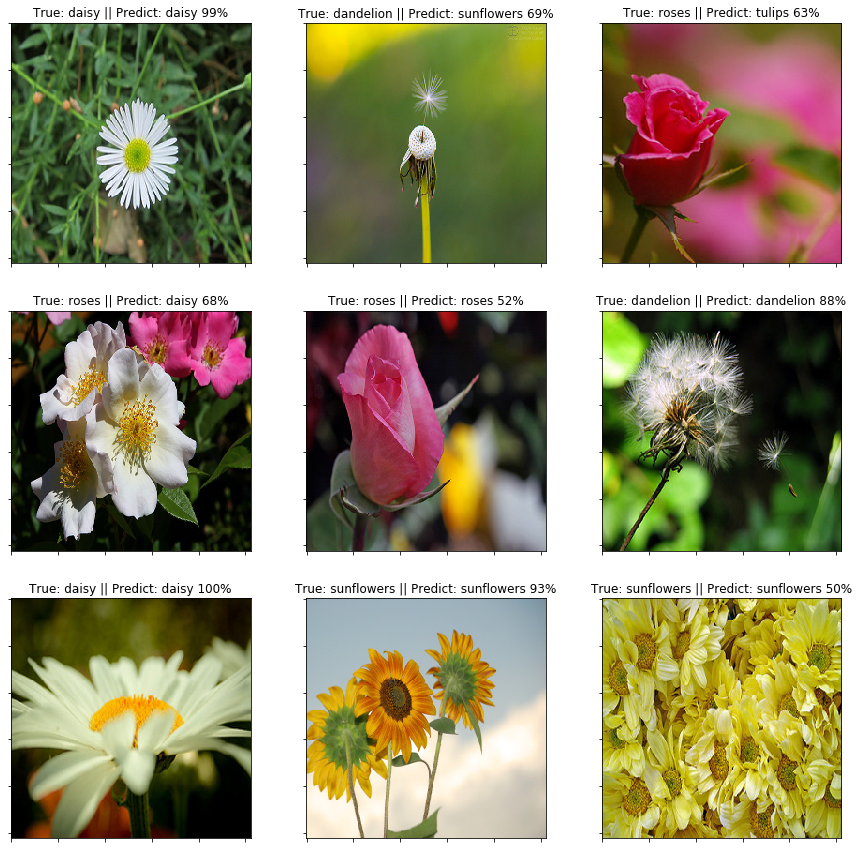

In [0]:
########################## PREDICTING USING MODEL FROM SCRATCH ####################################
#to predict the data 
def predict_val(val_data, model):
  val_input = np.reshape(val_data, (1, img_width, img_height, 3))
  val_input = val_input/255.
  pred = model.predict(val_input)
  #getting max probability to whic class the image belongs
  class_num = np.argmax(pred)
  return class_num, np.max(pred)


print("Model trained from scratch")
plt.figure(figsize=(15,15))
for i in range(9):
  #testing random image from validation dataset
  idx = np.random.randint(736)
  #plotting image
  ax = plt.subplot(3,3,i+1)
  plt.imshow(cvtRGB(val_data.astype('uint8')[idx]))
  category_idx = return_name(val_labels[idx])
  #predicting the class
  pred, prob = predict_val(val_data[idx], model_scratch)
  plt.title('True: %s || Predict: %s %d%%' % (categories[category_idx], categories[pred], round(prob, 2)*100))
  plt.grid(False)
  #for nat showing ticks on graph
  ax.set_yticklabels([])
  ax.set_xticklabels([])
  
plt.show()

Model trained from VGG19


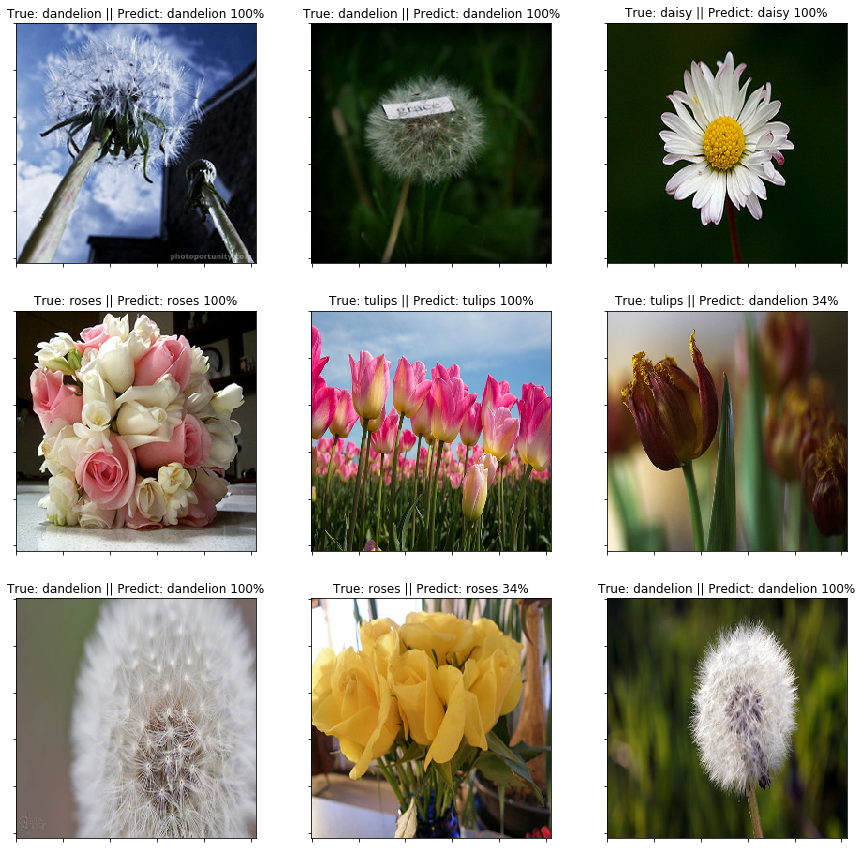

In [0]:
########################## PREDICTING USING TRANSFERRED MODEL USING VGG19 ####################################

print("Model trained from VGG19")
plt.figure(figsize=(15,15))
for i in range(9):
  
  idx = np.random.randint(200)
  
  ax = plt.subplot(3,3,i+1)
  plt.imshow(cvtRGB(val_data.astype('uint8')[idx]))
  category_idx = return_name(val_labels[idx])
  
  pred, prob = predict_val(val_data[idx], model_VGG19)
  plt.title('True: %s || Predict: %s %d%%' % (categories[category_idx], categories[pred], round(prob, 2)*100))
  plt.grid(False)
  ax.set_yticklabels([])
  ax.set_xticklabels([])
  
plt.show()


Model trained from ResNet50


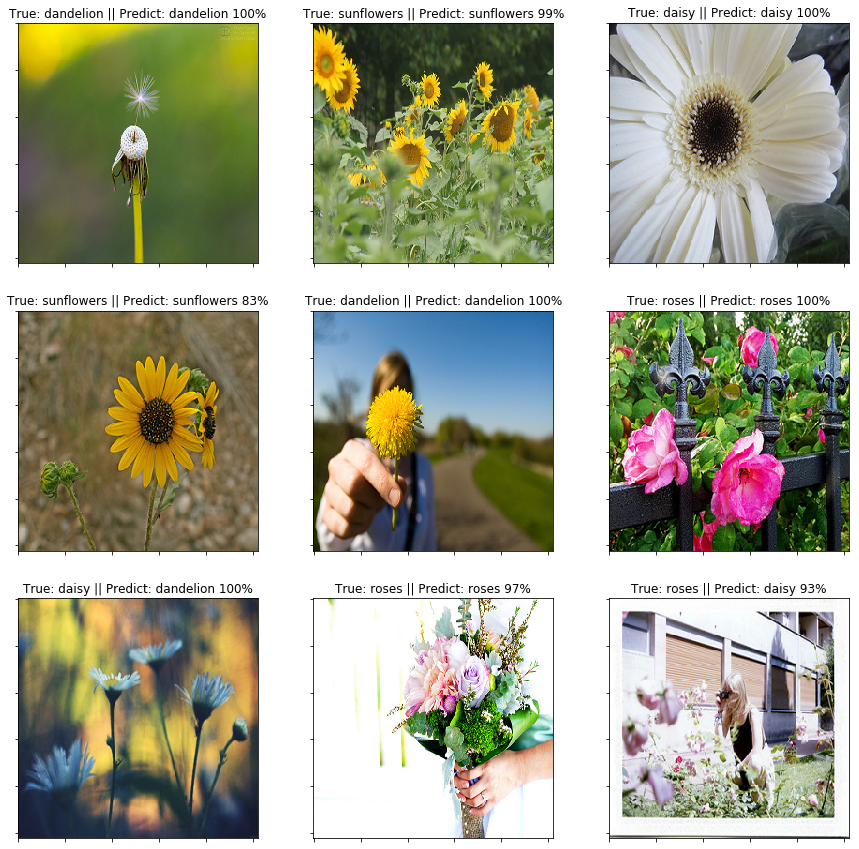

In [0]:
########################## PREDICTING USING MODEL FROM ResNet50 ####################################
print("Model trained from ResNet50")
plt.figure(figsize=(15,15))
for i in range(9):
  
  idx = np.random.randint(200)
  
  ax = plt.subplot(3,3,i+1)
  plt.imshow(cvtRGB(val_data.astype('uint8')[idx]))
  category_idx = return_name(val_labels[idx])
  
  pred, prob = predict_val(val_data[idx], model_ResNet50)
  plt.title('True: %s || Predict: %s %d%%' % (categories[category_idx], categories[pred], round(prob, 2)*100))
  plt.grid(False)
  ax.set_yticklabels([])
  ax.set_xticklabels([])
  
plt.show()


## **Predicting Test Image**

Using model from scratch
roses 69%


/usr/local/lib/python3.6/dist-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


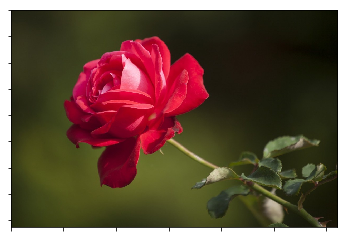

Using model from VGG19
roses 58%


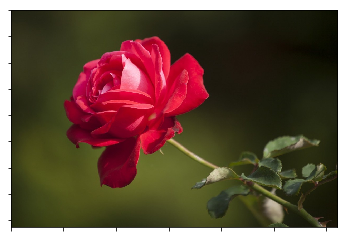

Using model from ResNet50
roses 100%


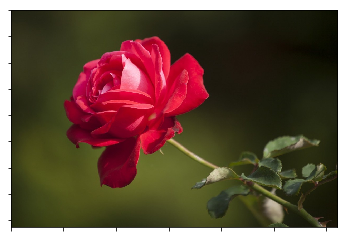

In [0]:
########################## PREDICTING SINGLE IMAGE ####################################
def predict_one_image(img, model):
  img = cv2.resize(img, (img_width, img_height), interpolation = cv2.INTER_CUBIC)
  img = np.reshape(img, (1, img_width, img_height, 3))
  img = img/255.
  pred = model.predict(img)
  class_num = np.argmax(pred)
  return class_num, np.max(pred)

print('Using model from scratch')
test_img = cv2.imread('/flowerDataset/toTestImages/rose2.jpg')
#predicting probabilities of an image
pred, probability = predict_one_image(test_img, model_scratch)
print('%s %d%%' % (categories[pred], round(probability, 2) * 100))
_, ax = plt.subplots(1)
plt.imshow(cvtRGB(test_img))
# Turn off tick labels
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.grid('off')
plt.show()

print('Using model from VGG19')
pred, probability = predict_one_image(test_img, model_VGG19)
print('%s %d%%' % (categories[pred], round(probability, 2) * 100))
_, ax = plt.subplots(1)
plt.imshow(cvtRGB(test_img))
# Turn off tick labels
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.grid('off')
plt.show()

print('Using model from ResNet50')
pred, probability = predict_one_image(test_img, model_ResNet50)
print('%s %d%%' % (categories[pred], round(probability, 2) * 100))
_, ax = plt.subplots(1)
plt.imshow(cvtRGB(test_img))
# Turn off tick labels
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.grid('off')
plt.show()

model_scratch


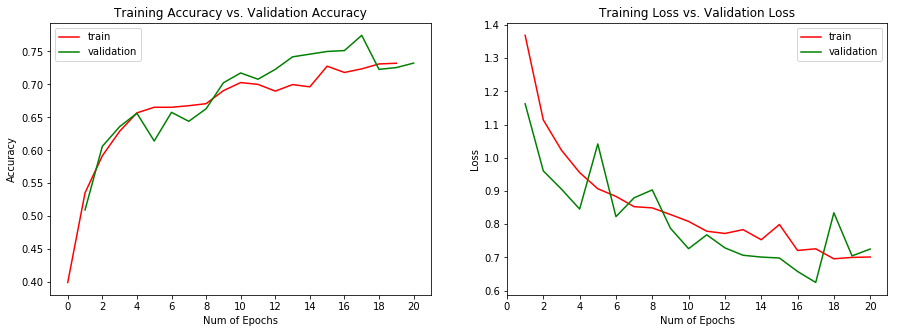

model_VGG19


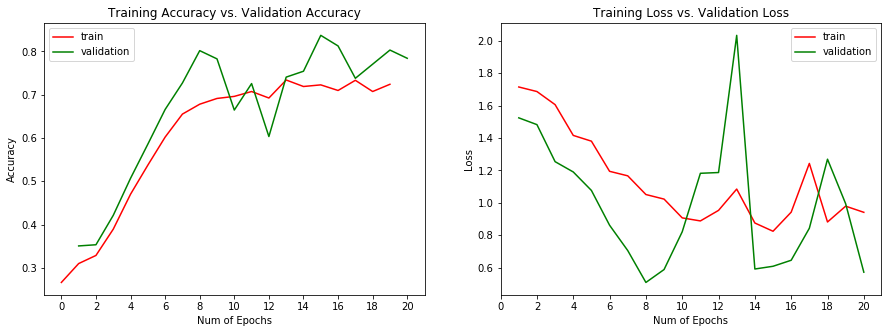

model_ResNet50


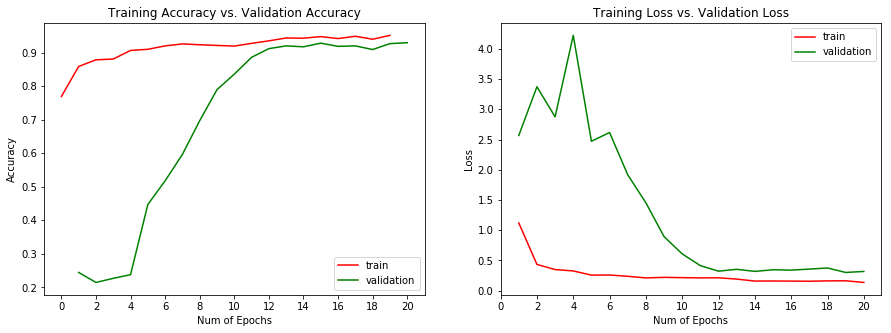

In [0]:
# Plotting training and testing process: loss and accuracy
def plot_model_history(model_name, history, epochs):
  print(model_name)
  plt.figure(figsize=(15, 5))
  
  # summarize history for accuracy
  plt.subplot(1, 2 ,1)
  plt.plot(np.arange(0, len(history['acc'])), history['acc'], 'r')
  plt.plot(np.arange(1, len(history['val_acc'])+1), history['val_acc'], 'g')
  plt.xticks(np.arange(0, epochs+1, epochs/10))
  plt.title('Training Accuracy vs. Validation Accuracy')
  plt.xlabel('Num of Epochs')
  plt.ylabel('Accuracy')
  plt.legend(['train', 'validation'], loc='best')
  
  plt.subplot(1, 2, 2)
  plt.plot(np.arange(1, len(history['loss'])+1), history['loss'], 'r')
  plt.plot(np.arange(1, len(history['val_loss'])+1), history['val_loss'], 'g')
  plt.xticks(np.arange(0, epochs+1, epochs/10))
  plt.title('Training Loss vs. Validation Loss')
  plt.xlabel('Num of Epochs')
  plt.ylabel('Loss')
  plt.legend(['train', 'validation'], loc='best')
    
  plt.show()
#plotting all three models
plot_model_history('model_scratch', model_scratch_history.history, 20)
plot_model_history('model_VGG19', model_VGG19_history.history, 20)
plot_model_history('model_ResNet50', model_ResNet50_history.history, 20)

## **HeatMapsVisualization**

In [31]:
#importing libraries
from tensorflow.python.keras.preprocessing import image
import numpy as np

# path to test image
img_path = '/flowerDataset/toTestImages/sunflower1.jpg'
# resizing the image 256x256
img = image.load_img(img_path, target_size=(256, 256))
#converting to numpy array
x = image.img_to_array(img)
#reshaping and rescaling image
x = np.expand_dims(x, axis=0)
x = x/255.
#predicting image for classification
preds = model_VGG19.predict(x)
#get the class of highest probability
class_num = np.argmax(preds)
print(preds)
max_ind=np.argmax(preds[0])
print(max_ind)

[[2.5977718e-03 1.1040334e-04 8.3803275e-09 9.9729049e-01 1.2978644e-06]]
3


In [32]:
#get all the layers of the model
[layer.name for layer in model_VGG19.layers]

['input_2',
 'block1_conv1',
 'block1_conv2',
 'block1_pool',
 'block2_conv1',
 'block2_conv2',
 'block2_pool',
 'block3_conv1',
 'block3_conv2',
 'block3_conv3',
 'block3_conv4',
 'block3_pool',
 'block4_conv1',
 'block4_conv2',
 'block4_conv3',
 'block4_conv4',
 'block4_pool',
 'block5_conv1',
 'block5_conv2',
 'block5_conv3',
 'block5_conv4',
 'block5_pool',
 'flatten_1',
 'dense_2',
 'dropout_1',
 'dense_3']

In [0]:
#using keras backend module
from tensorflow.python.keras import backend as K

layer_names = ['block1_conv1', 'block1_conv2', 
               'block2_conv1', 'block2_conv2', 
               'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_conv4',
               'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_conv4',
               'block5_conv1', 'block5_conv2', 'block5_conv3','block5_conv4']

# get prediction output vector
pred_vector_output = model_VGG19.output[:, max_ind]
#declare heatmap list
heatmap = []
for layer_name in layer_names:
    #get layer from VGG19 transferred model
    some_conv_layer = model_VGG19.get_layer(layer_name)

    # Calculating gradient of the predicted class for specified layer
    grads = K.gradients(pred_vector_output, some_conv_layer.output)[0]

    # calculating mean intensity of the gradient over a specific feature map channel
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # accessing gradient values of given layer
    iterate = K.function([model_VGG19.input], [pooled_grads, some_conv_layer.output[0]])

    # getting numpy format
    pooled_grads_value, conv_layer_output_value = iterate([x])

    # Multipling each channel in the feature map array with regard to the sunflower class
    for i in range(model_VGG19.get_layer(layer_name).output_shape[-1]):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    # calculating mean channel-wise of the resulting feature map
    # and appending to heatmap
    heatmap.append(np.mean(conv_layer_output_value, axis=-1))

In [34]:
len(heatmap)

16

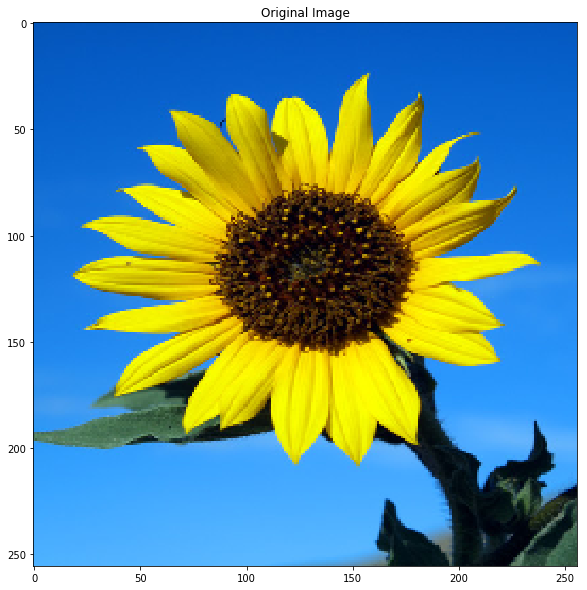

In [35]:
#plotting original image
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.title('Original Image')
plt.show()

<Figure size 1296x1296 with 0 Axes>

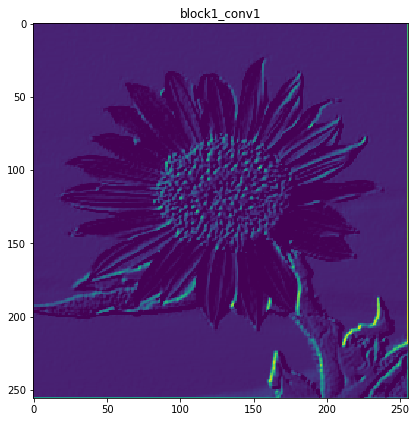

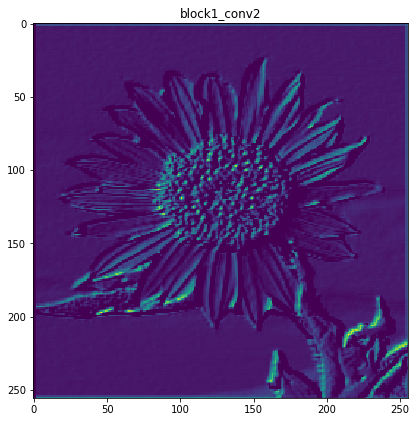

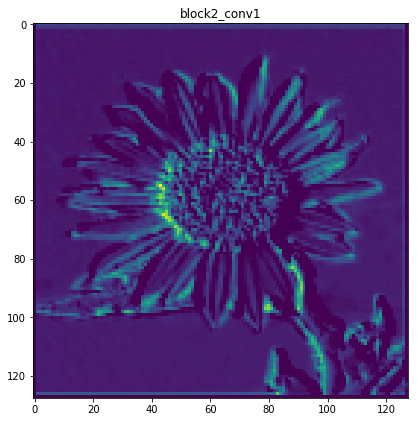

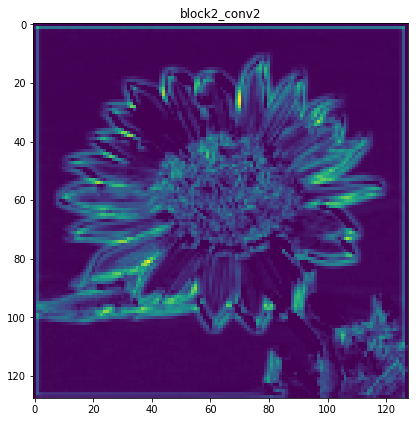

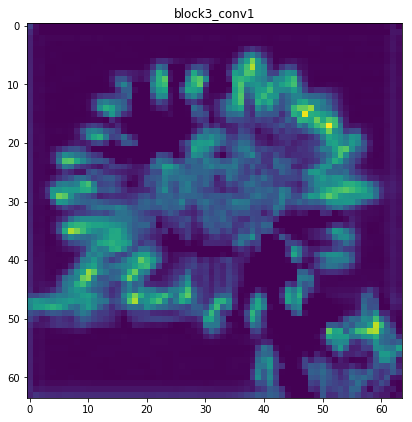

...

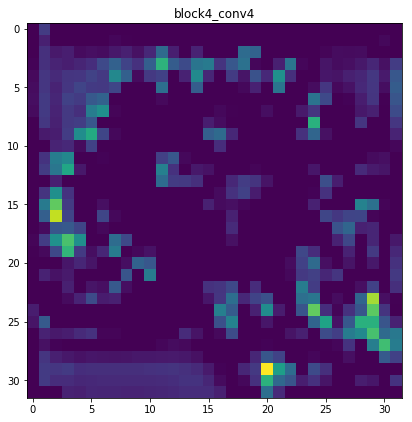

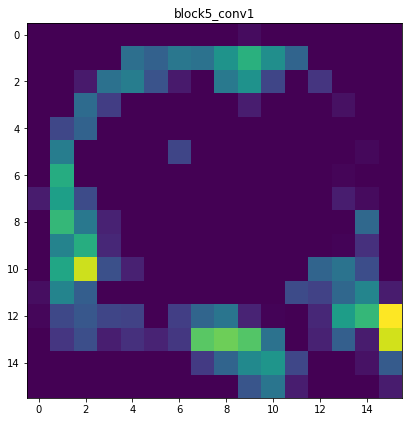

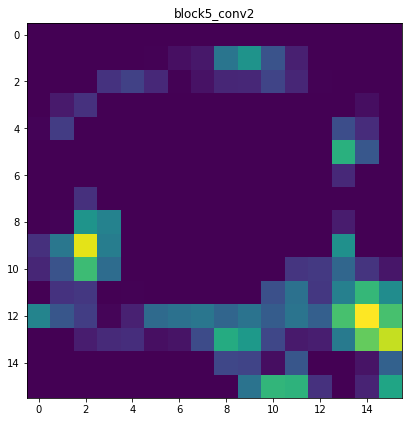

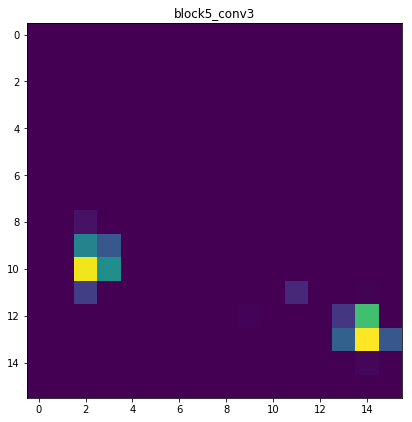

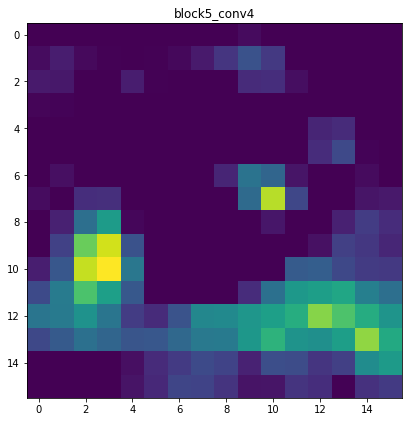

In [37]:
#plotting heatmap images for each layer of model
plt.figure(figsize=(18, 18))

for i in range(16):
    plt.figure(figsize=(40,40))
   # print(i)
    plt.subplot(5, 4, i+1)
    img_heatmap = np.maximum(heatmap[i], 0)
    img_heatmap /= np.max(img_heatmap)
    plt.imshow(img_heatmap)
    plt.title(layer_names[i])
    plt.show()

In [0]:
import cv2
#read the original image
img = cv2.imread(img_path)
for i, hm in enumerate(heatmap):
    #access heatmap
    img_heatmap = np.maximum(hm, 0)
    img_heatmap /= np.max(img_heatmap)
    #resizing the heatmap to the same size as the original image
    img_hm = cv2.resize(img_heatmap, (img.shape[1], img.shape[0]))
    # converting heatmap to RGB
    img_hm = np.uint8(255 * img_hm)
    #applying heatmap to the original image in COLORMAP_JET format
    img_hm = cv2.applyColorMap(img_hm, cv2.COLORMAP_JET)
    # 0.4:heatmap intensity factor and superimposed heatmap on original image
    superimposed_img = img_hm * 0.4 + img
    # Save the image to disk
    cv2.imwrite('/flowerDataset/toTestImages/heatmapOutput/sunflower1_{}.jpg'.format(layer_names[i]), superimposed_img)

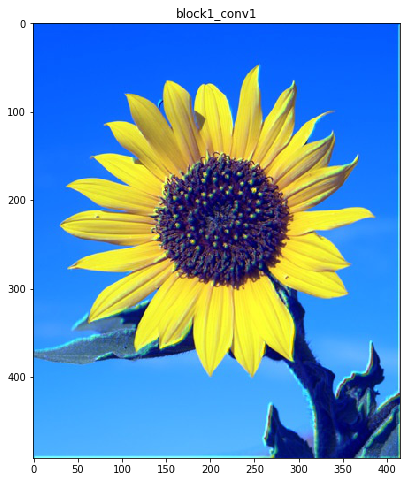

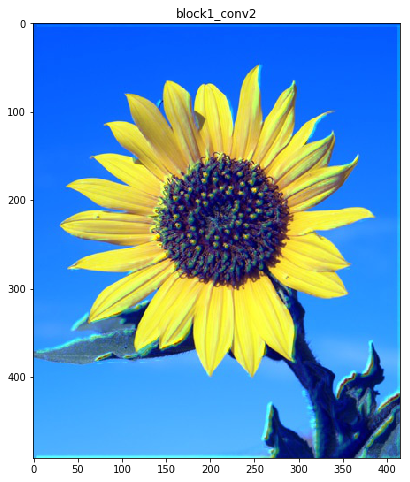

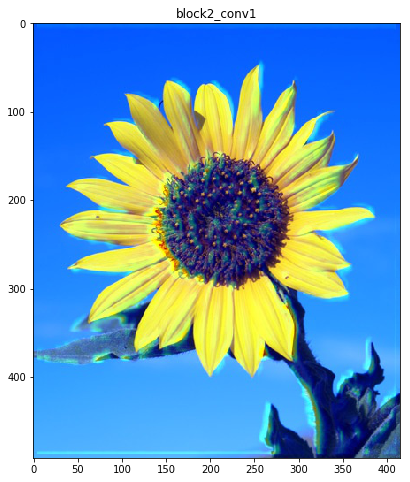

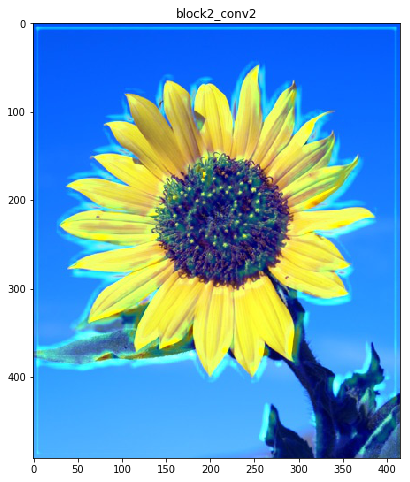

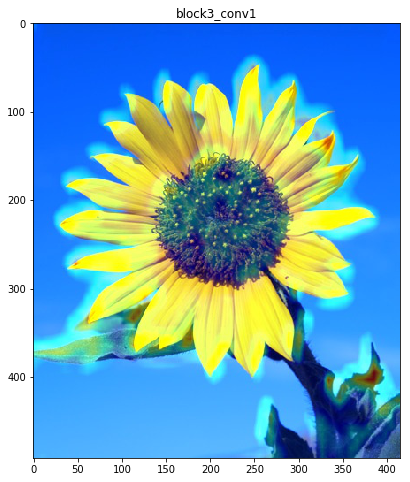

...

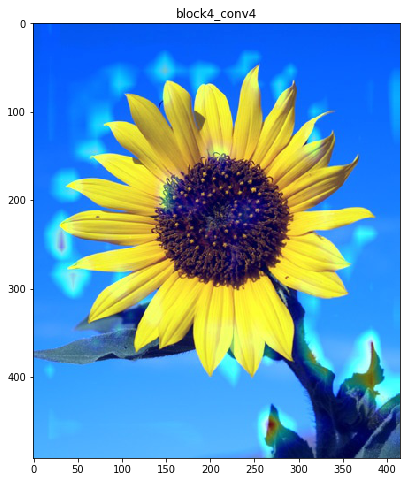

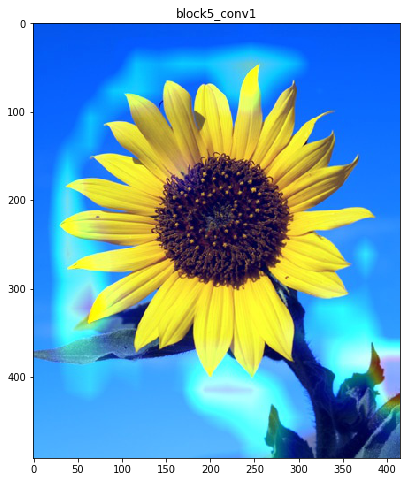

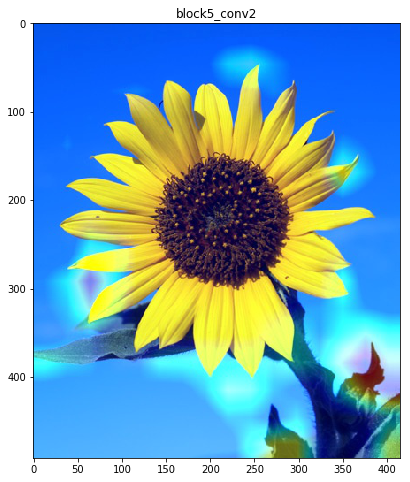

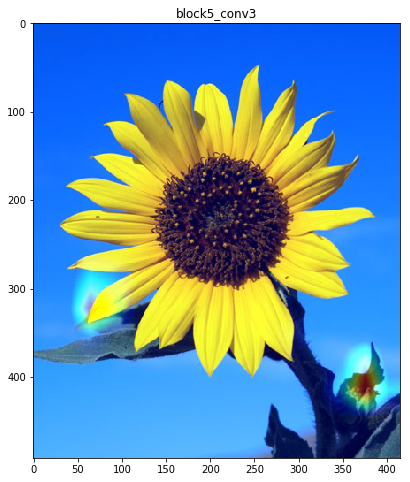

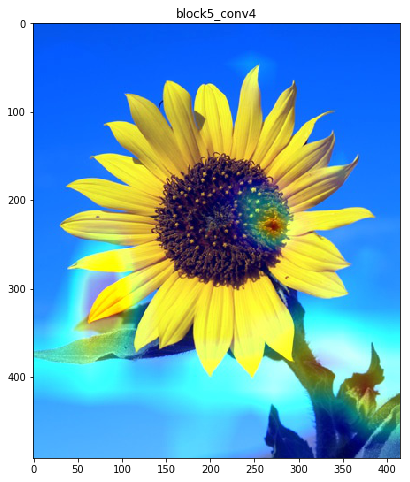

In [66]:
#plotting all heatmap images
for i in range(len(layer_names)):
  img_to_plot = image.img_to_array(
      image.load_img('/flowerDataset/toTestImages/heatmapOutput/sunflower1_{}.jpg'.format(layer_names[i]))) / 255.
  fig = plt.figure(figsize=(8, 8))
  plt.imshow(img_to_plot)
  plt.title(layer_names[i])
  

## **Visualizing Intermediate Activation**

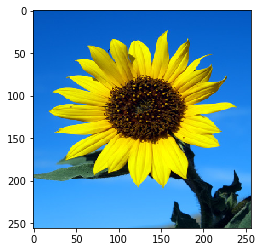

In [0]:
#plotting original image
from keras.preprocessing.image import load_img, img_to_array
img = load_img('/flowerDataset/flower_photos/sunflower1.jpg', target_size=(256, 256))
img_tensor = img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255.

plt.imshow(img_tensor[0])
plt.show()

(1, 256, 256, 64)


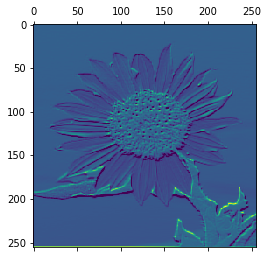

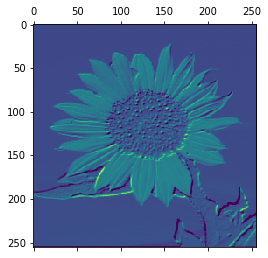

In [0]:

from tensorflow.python.keras import models
#for each layer get the activation 
layers_output = [layer.output for layer in model_VGG19.layers[1:]]
activation_model = models.Model(inputs=model_VGG19.inputs, outputs=layers_output)
#getting activations of each layer
activations = activation_model.predict(img_tensor)
#access first layer of activation
first_layer_activation = activations[0]
print(first_layer_activation.shape)
#plotting first layer activation
plt.matshow(first_layer_activation[0, :, :, 3], cmap='viridis')
plt.show()
plt.matshow(first_layer_activation[0, :, :, 30], cmap='viridis')
plt.show()
# get all layers of the model to plot
layer_names = [layer.name for layer in model_VGG19.layers[:21]]



input_2
4
1024 4096


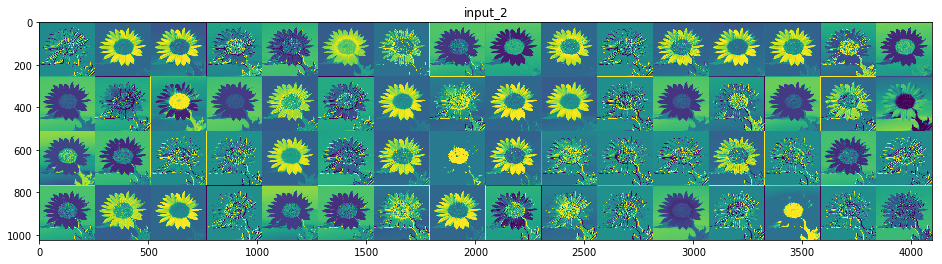

block1_conv1
4
1024 4096


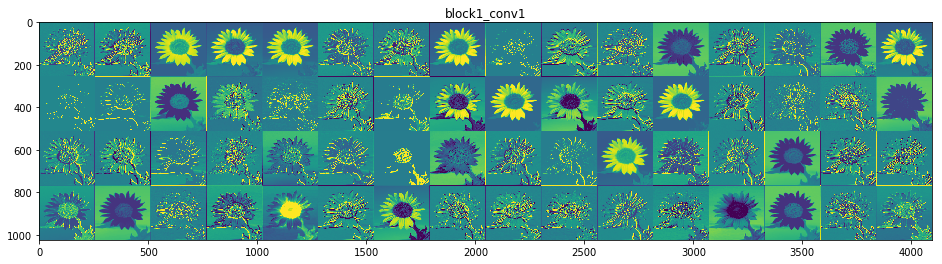

block1_conv2
4
512 2048


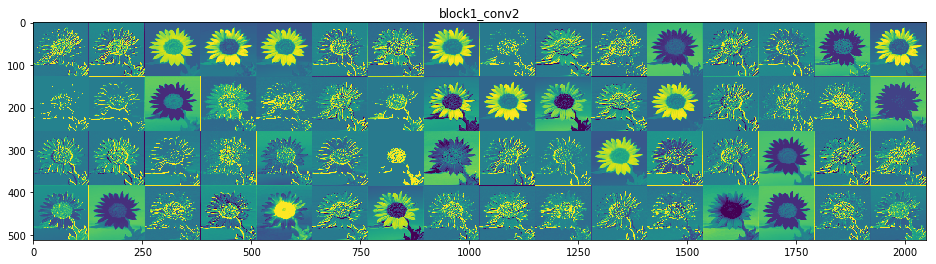

block1_pool
8
1024 2048


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in true_divide


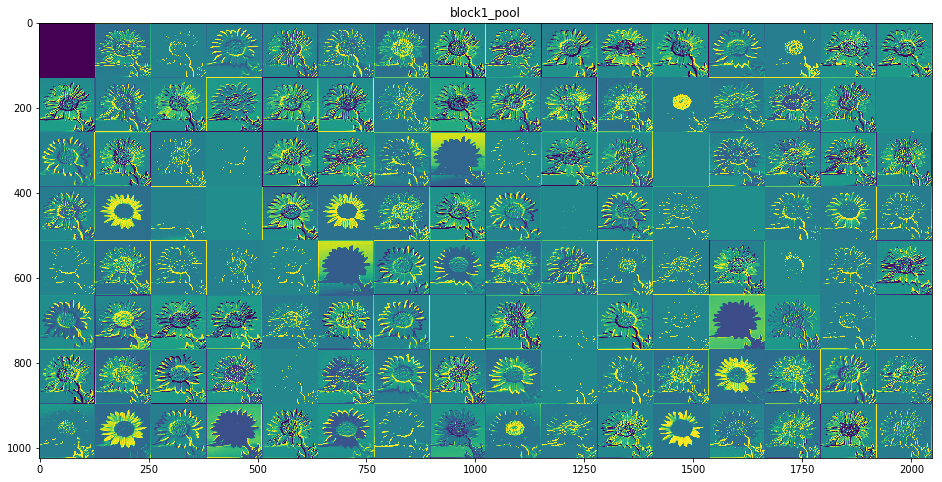

block2_conv1
8
1024 2048


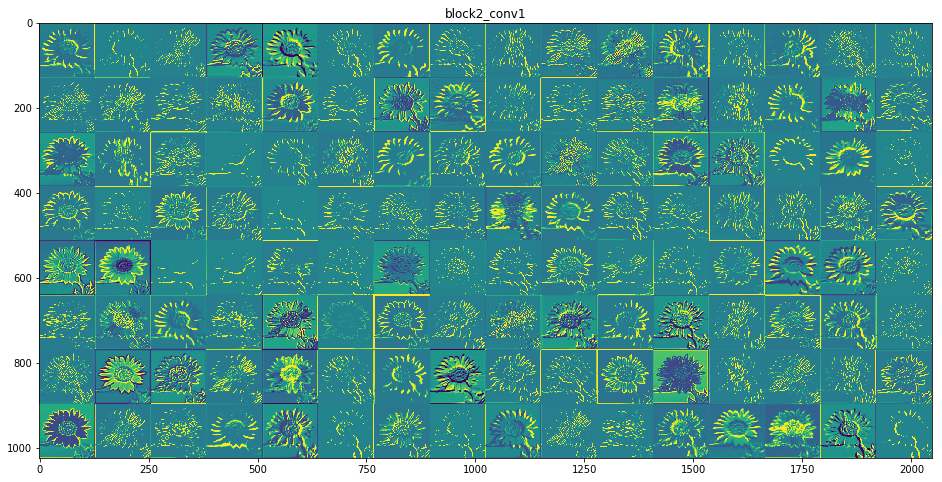

block2_conv2
8
512 1024


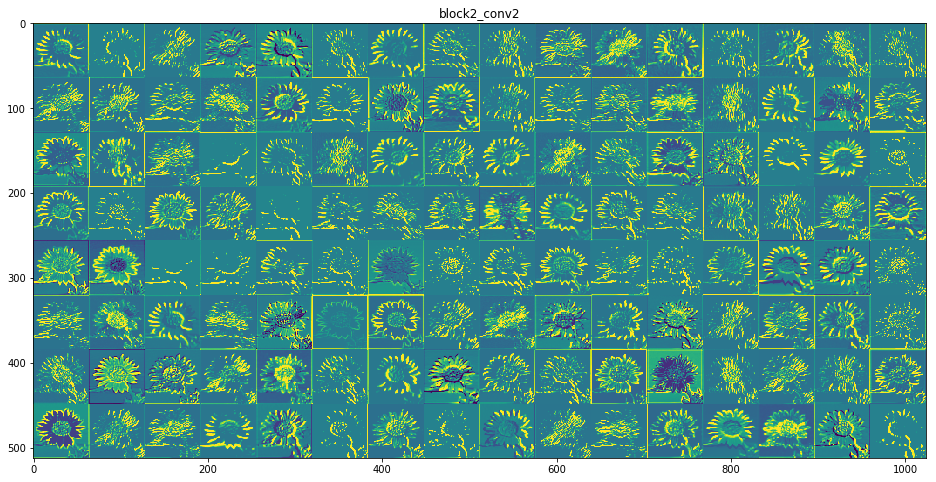

block2_pool
16
1024 1024


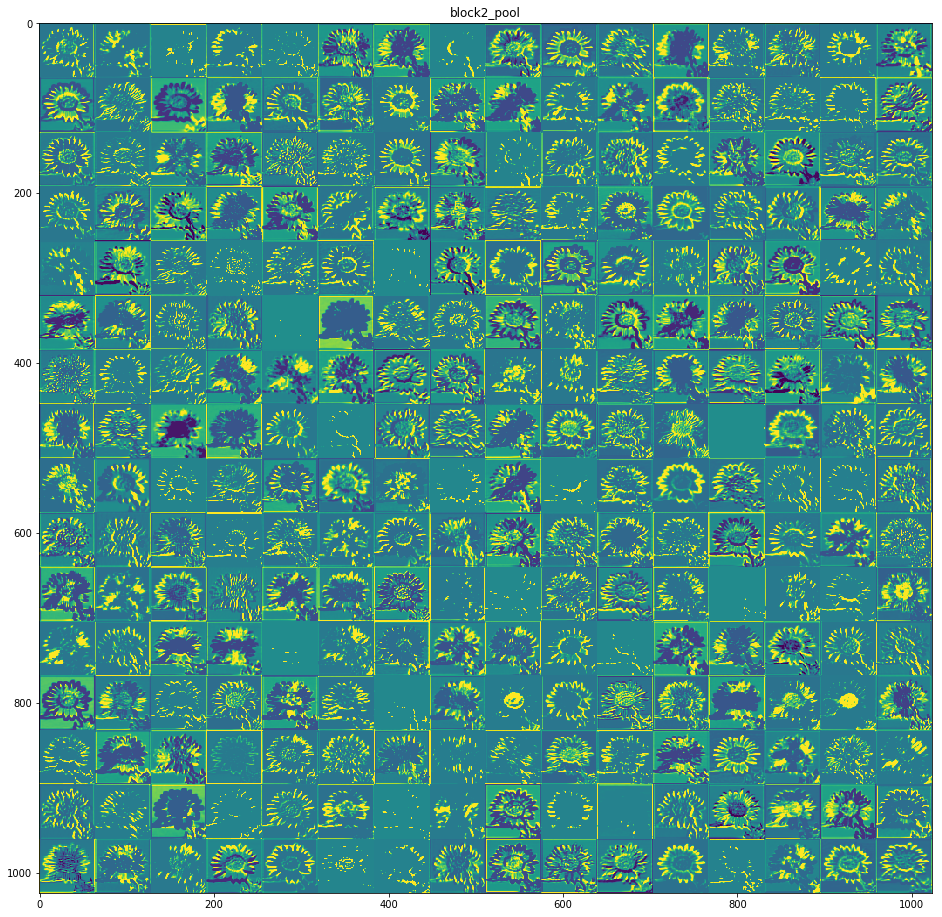

block3_conv1
16
1024 1024


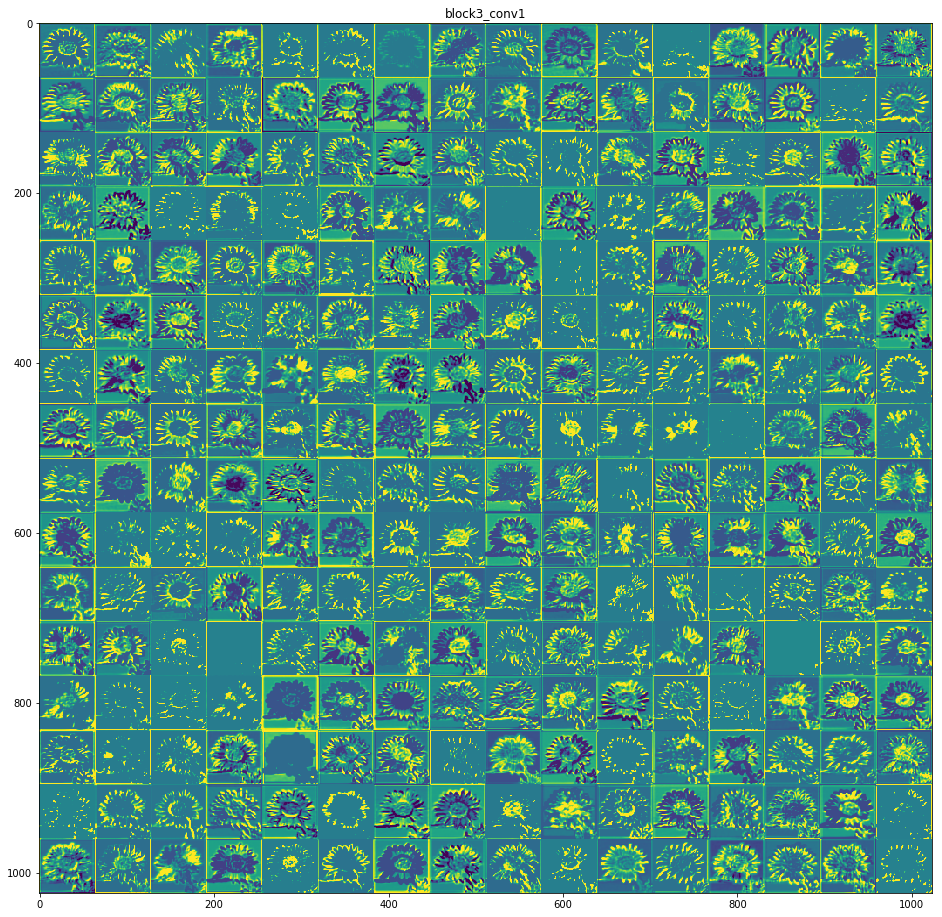

block3_conv2
16
1024 1024


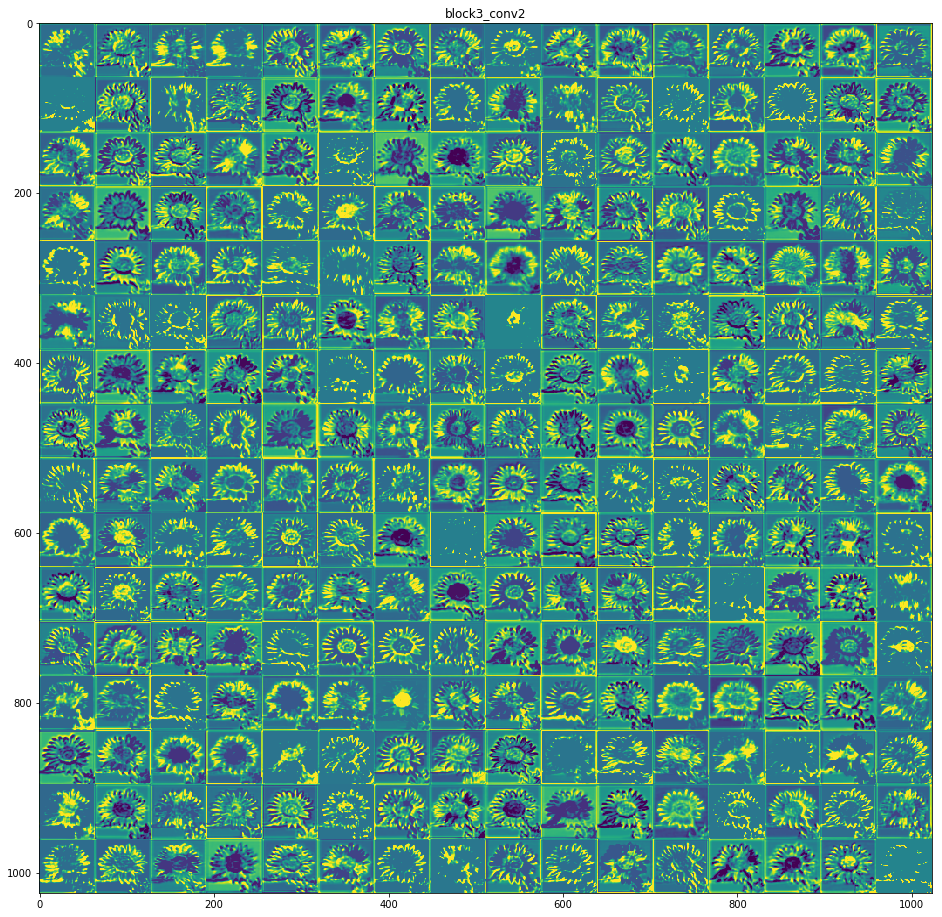

block3_conv3
16
1024 1024


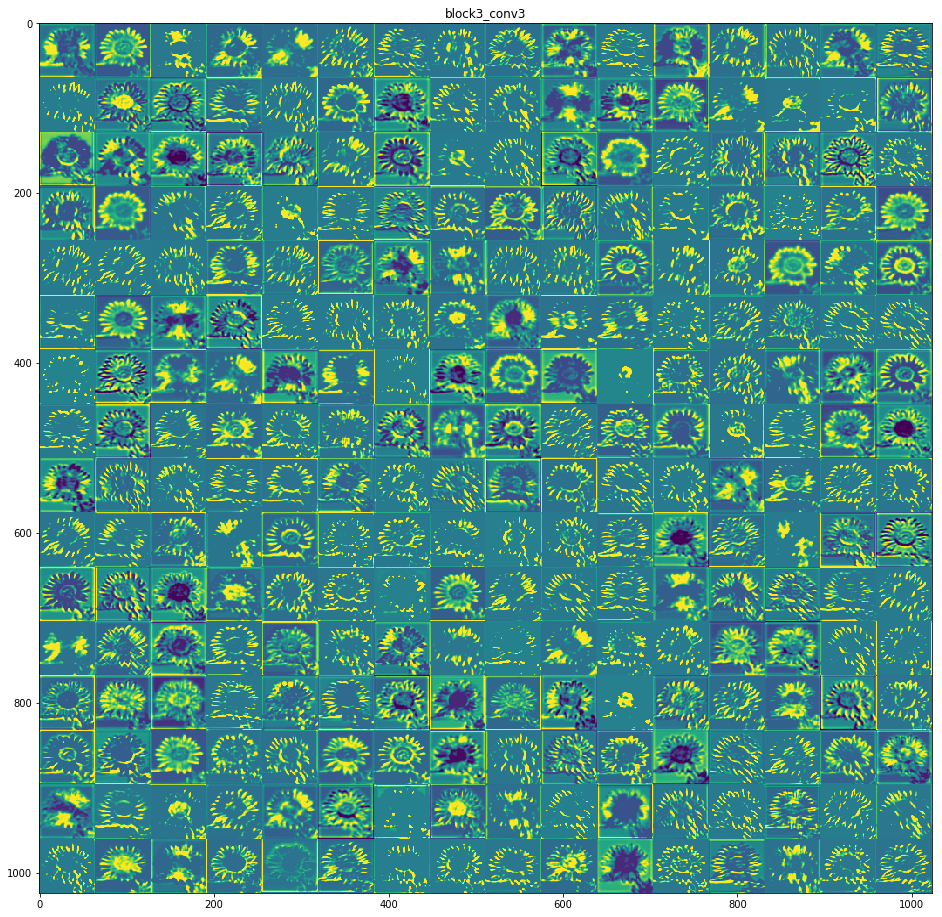

block3_conv4
16
512 512


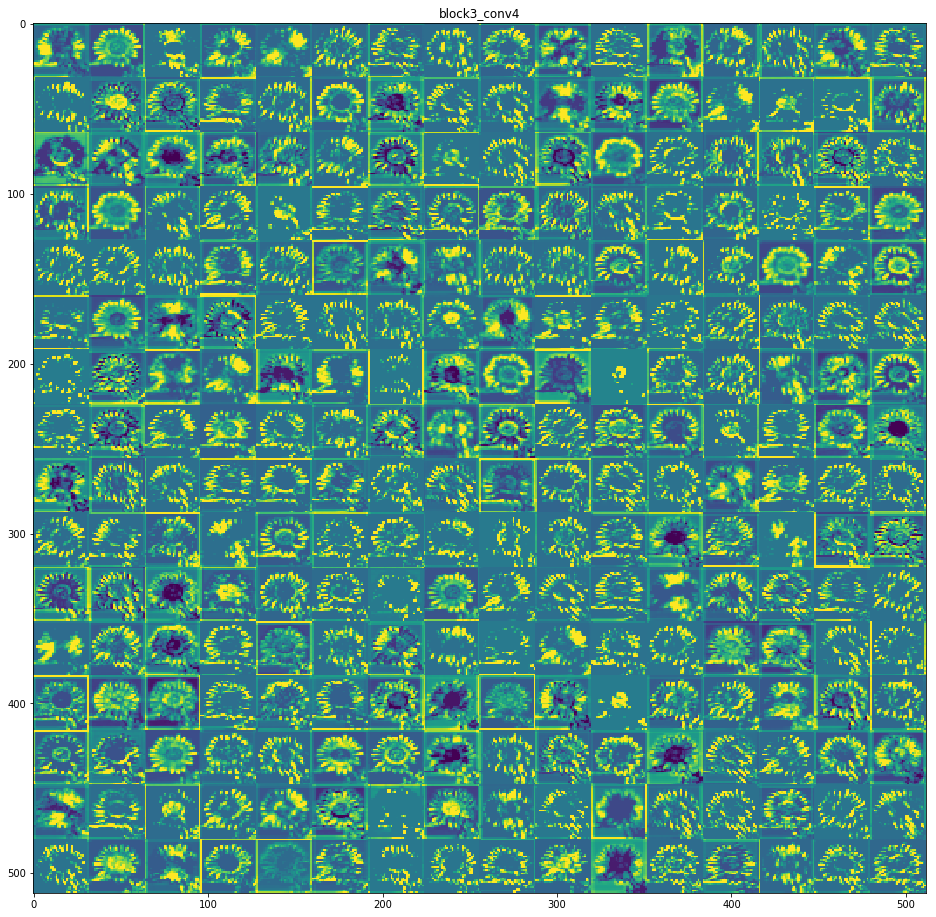

block3_pool
32
1024 512


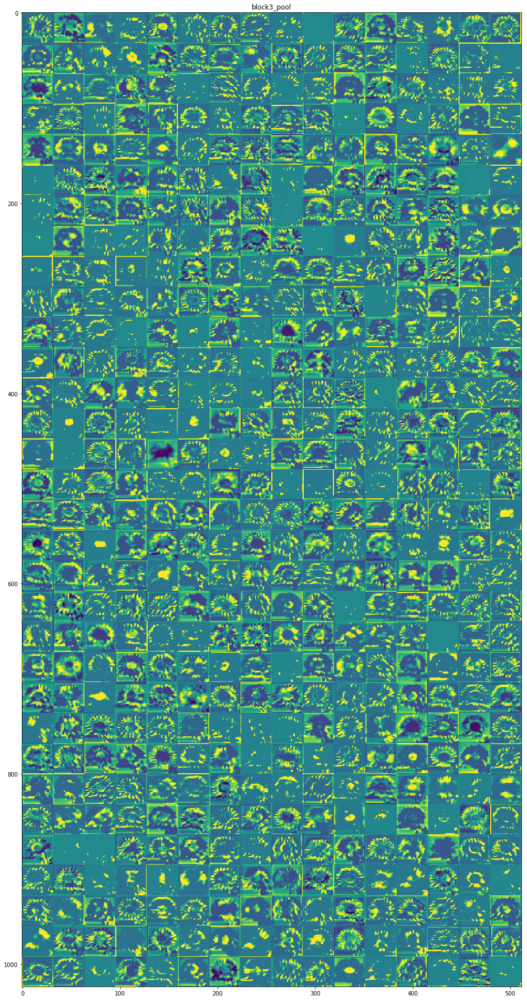

block4_conv1
32
1024 512


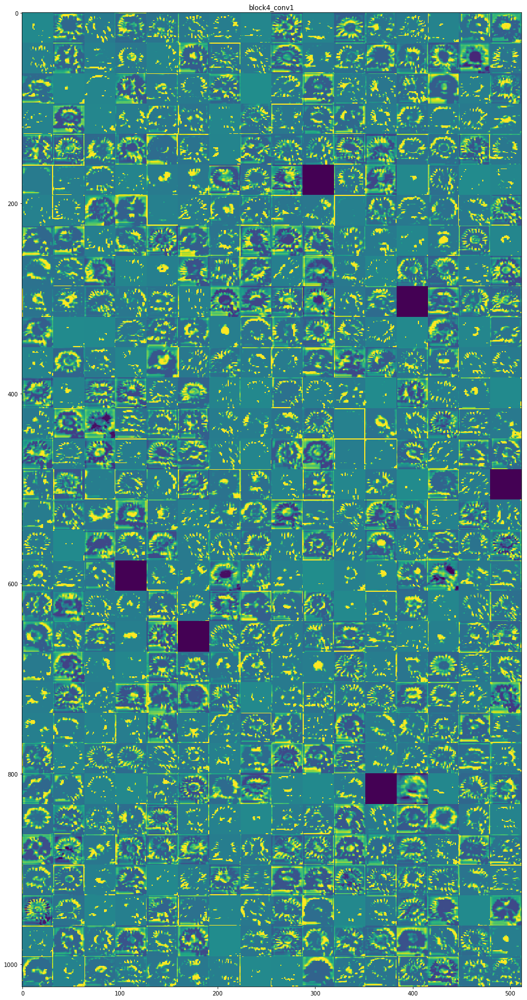

block4_conv2
32
1024 512


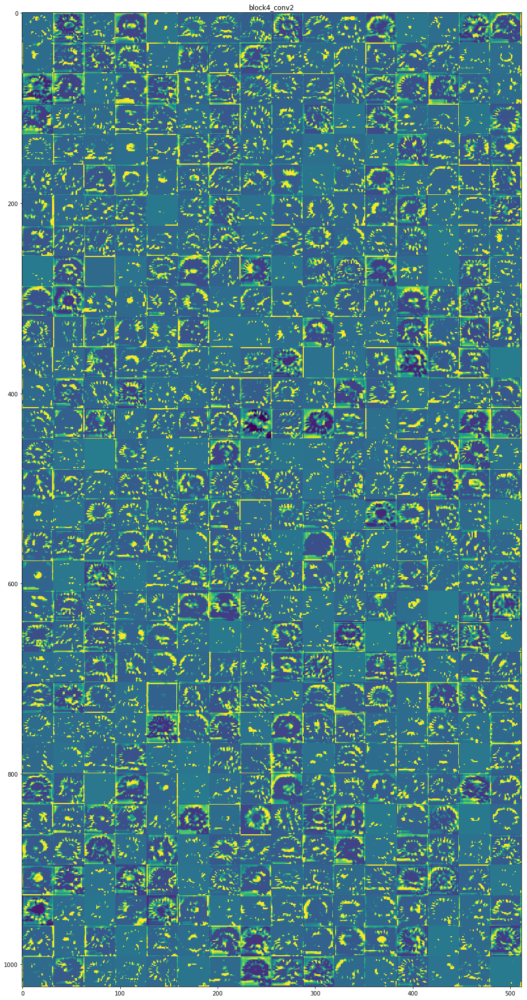

block4_conv3
32
1024 512


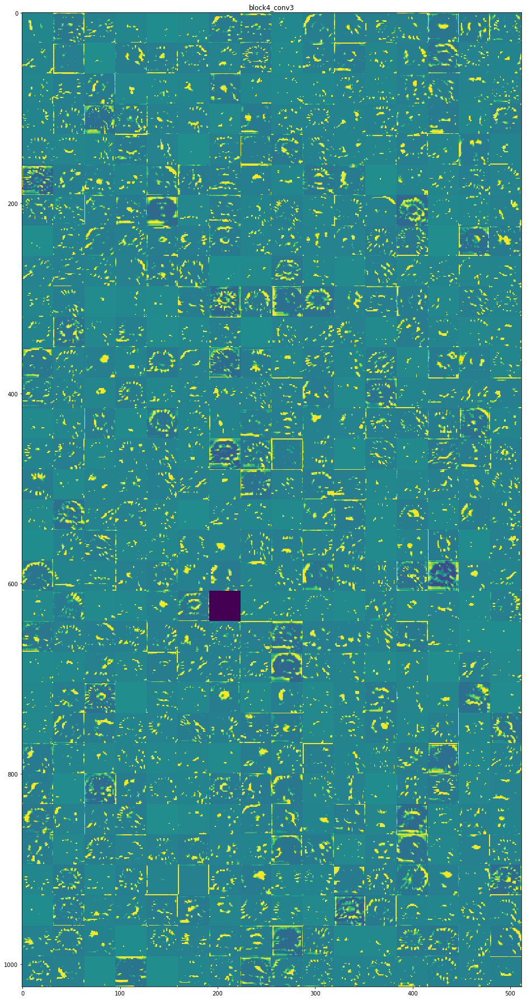

block4_conv4
32
512 256


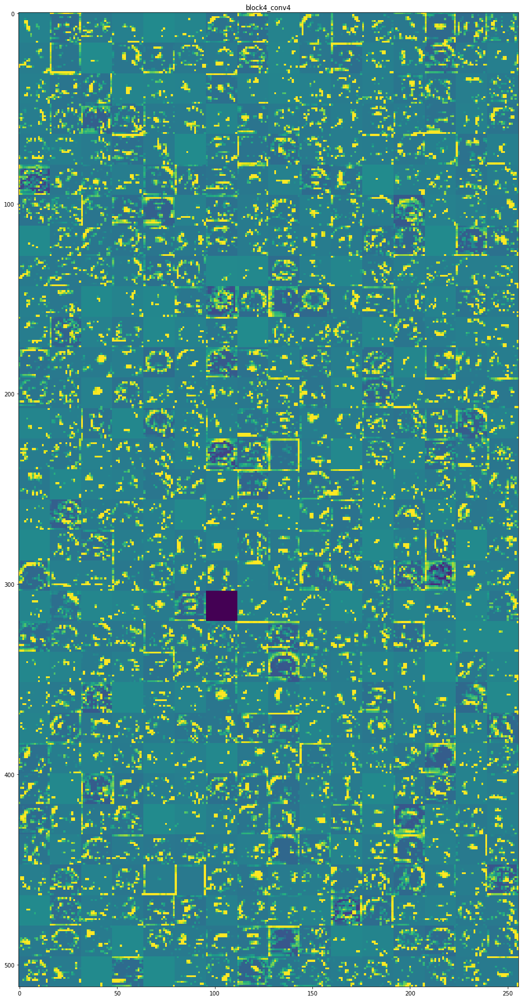

block4_pool
32
512 256


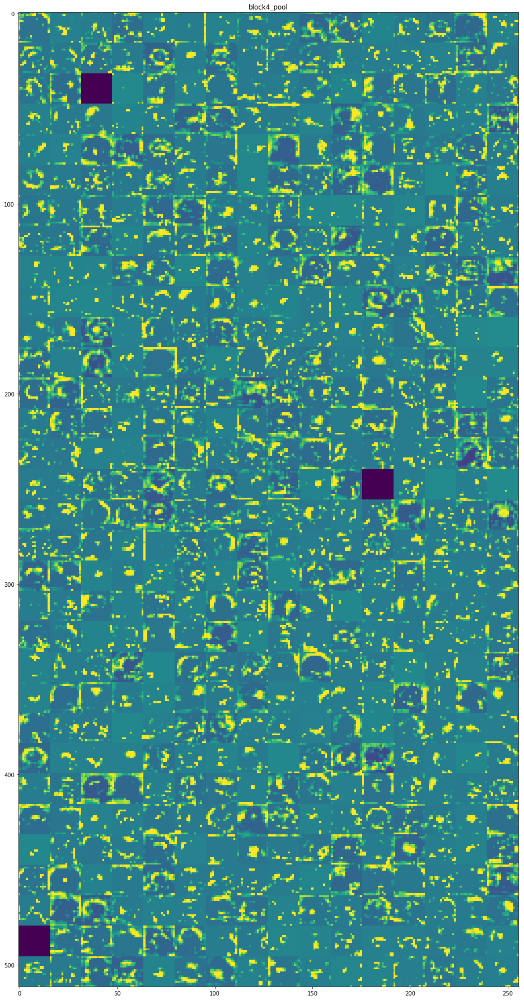

block5_conv1
32
512 256


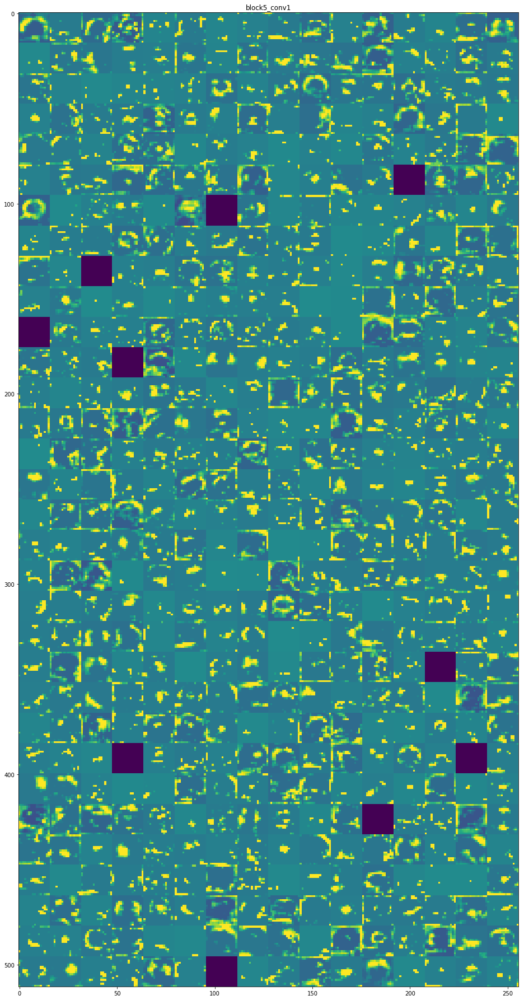

block5_conv2
32
512 256


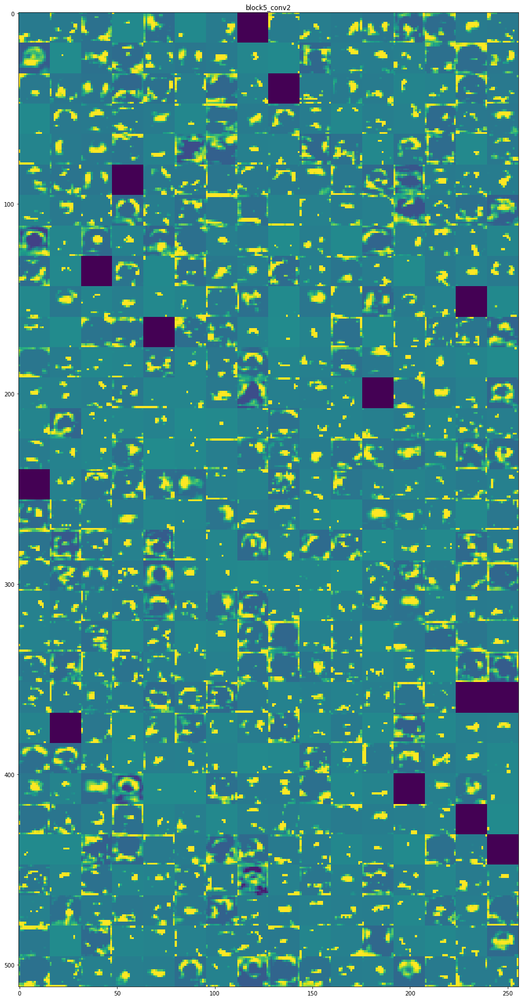

block5_conv3
32
512 256


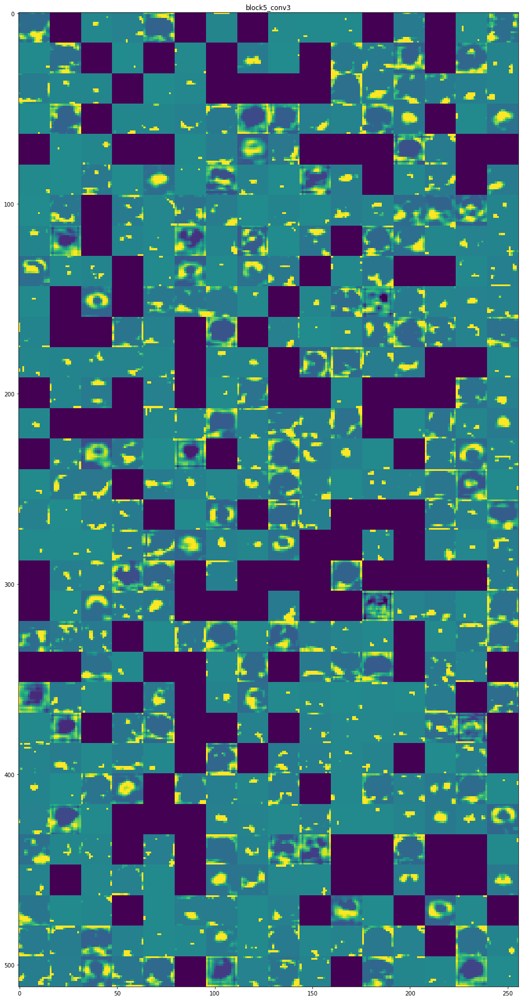

block5_conv4
32
256 128


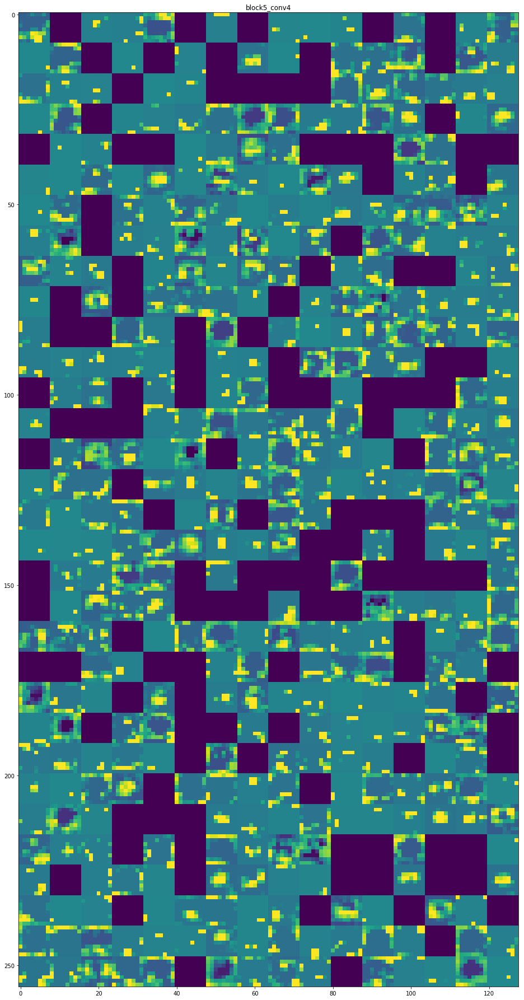

In [0]:
#decalre rows to plot in grid
images_per_row = 16
#looping through all the activation layers
for layer_name, layer_activation in zip(layer_names, activations):
    # number of features in the feature map
    n_features = layer_activation.shape[-1]
    # size of the feature maps
    size = layer_activation.shape[1]
    #set the size of the grid
    n_cols = n_features // images_per_row
    print(layer_name)
    print(n_cols)
    print(size * n_cols, images_per_row * size)
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    # loop through grid and plot the activation model 
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size: (col + 1) * size,
            row * size: (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    plt.show()

## **Visualizing convnet filters**

In [0]:
#using keras backend module
from tensorflow.python.keras import backend as K
#method to normalize the tensor with std 0.1
def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    # clip to [0, 1]s
    x += 0.5
    x = np.clip(x, 0, 1)
    return x
#to generate pattern for specified layer
def generate_pattern(layer_name, filter_index, size=150):
    # get a loss that maximizes the activation of the nth filter of the layer considered.
    layer_output = model_VGG19.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])
    # calculate the gradient of the input picture using above loss
    grads = K.gradients(loss, model_VGG19.input)[0]
    # normalizing gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    # get loss and gradient of the given image
    iterate = K.function([model_VGG19.input], [loss, grads])
    # Initializing with a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3))
    # calculate gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        if i == 39:
            print(layer_name, filter_index, loss_value)
    img = input_img_data[0]
    return deprocess_image(img)

block1_conv1 0 77.558846
block1_conv1 8 150.15314
block1_conv1 16 120.76225
block1_conv1 24 47.739983
block1_conv1 32 80.83299
block1_conv1 40 73.915115
block1_conv1 48 62.241577
block1_conv1 56 54.533424
block1_conv1 1 84.1716
block1_conv1 9 85.750015
block1_conv1 17 46.695805
block1_conv1 25 145.40695
block1_conv1 33 66.95899
block1_conv1 41 70.46677
block1_conv1 49 72.70971
block1_conv1 57 71.203545
block1_conv1 2 59.26097
block1_conv1 10 83.85202
block1_conv1 18 151.27844
block1_conv1 26 79.58419
block1_conv1 34 60.084255
block1_conv1 42 46.43724
block1_conv1 50 105.97652
block1_conv1 58 68.00564
block1_conv1 3 73.16754
block1_conv1 11 60.30634
block1_conv1 19 126.51189
block1_conv1 27 123.33669
block1_conv1 35 58.01816
block1_conv1 43 52.547733
block1_conv1 51 98.46334
block1_conv1 59 165.43668
block1_conv1 4 44.222103
block1_conv1 12 242.45163
block1_conv1 20 84.379005
block1_conv1 28 64.53987
block1_conv1 36 100.400986
block1_conv1 44 33.51975
block1_conv1 52 99.15509
block1_con

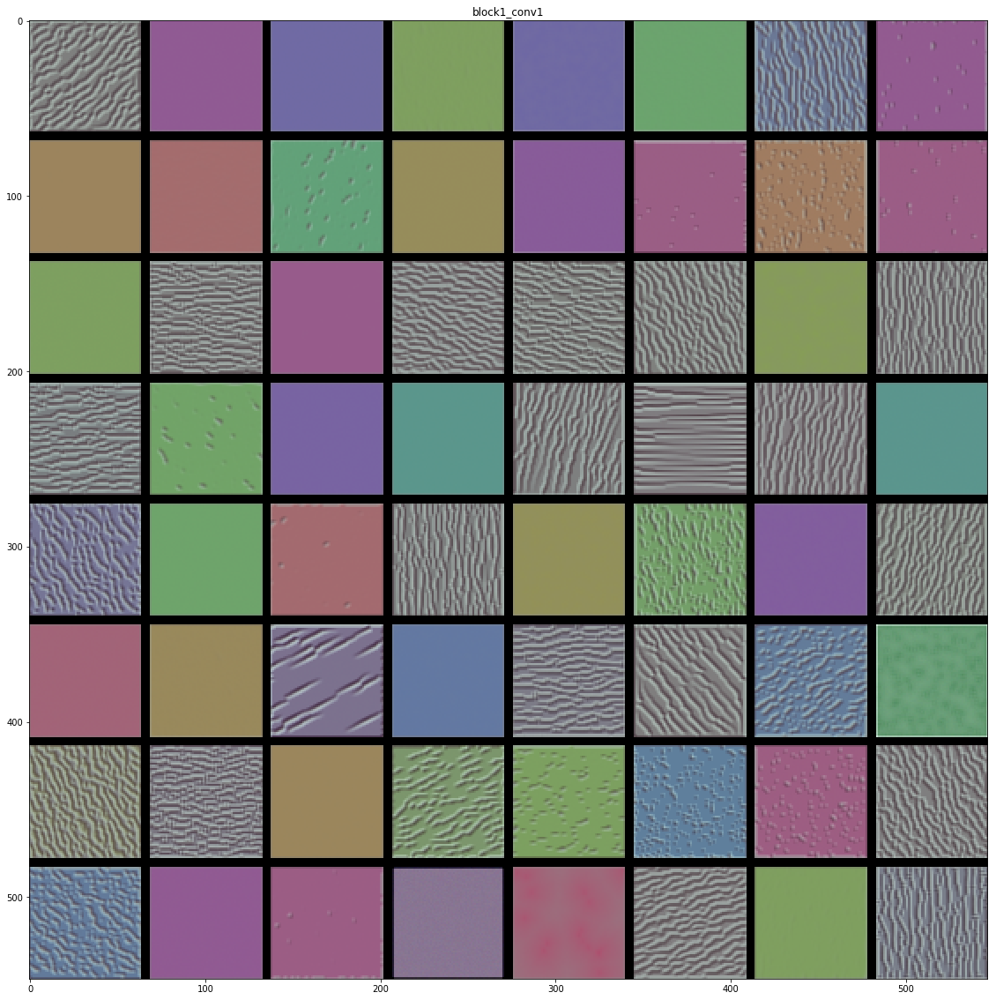

block1_conv2 0 364.35742
block1_conv2 8 283.2434
block1_conv2 16 264.6325
block1_conv2 24 663.64996
block1_conv2 32 229.85558
block1_conv2 40 302.2516
block1_conv2 48 198.42319
block1_conv2 56 293.3256
block1_conv2 1 179.41644
block1_conv2 9 175.14857
block1_conv2 17 266.12863
block1_conv2 25 280.1936
block1_conv2 33 267.59158
block1_conv2 41 218.9755
block1_conv2 49 536.7912
block1_conv2 57 324.67908
block1_conv2 2 1248.3044
block1_conv2 10 379.5423
block1_conv2 18 1242.4517
block1_conv2 26 280.9359
block1_conv2 34 214.14018
block1_conv2 42 568.1346
block1_conv2 50 418.956
block1_conv2 58 256.65305
block1_conv2 3 581.5848
block1_conv2 11 536.07635
block1_conv2 19 339.49548
block1_conv2 27 305.93323
block1_conv2 35 300.21866
block1_conv2 43 217.38466
block1_conv2 51 158.34453
block1_conv2 59 343.66095
block1_conv2 4 744.63824
block1_conv2 12 239.08244
block1_conv2 20 405.75058
block1_conv2 28 356.1568
block1_conv2 36 158.23563
block1_conv2 44 259.1632
block1_conv2 52 947.77155
block1_c

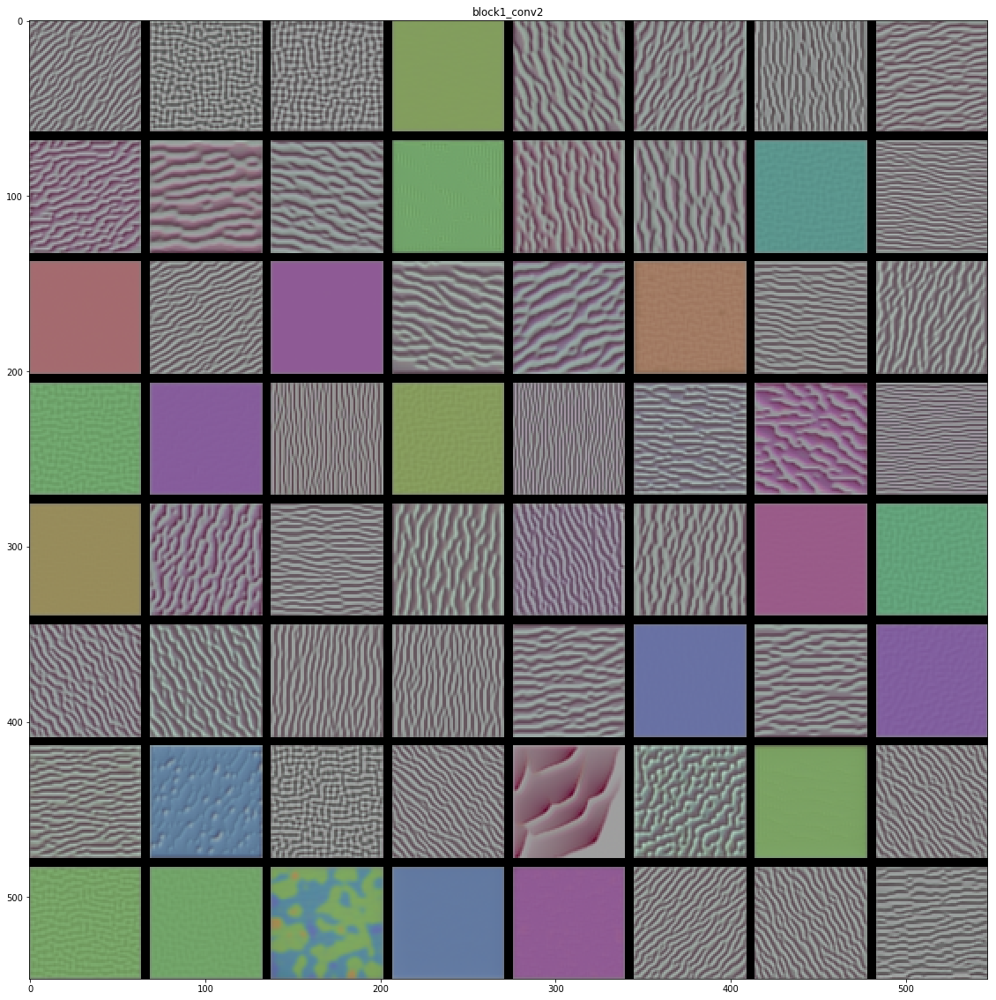

block2_conv1 0 0.0
block2_conv1 8 443.60483
block2_conv1 16 356.11255
block2_conv1 24 529.34247
block2_conv1 32 1175.8112
block2_conv1 40 0.0
block2_conv1 48 545.0205
block2_conv1 56 1089.3168
block2_conv1 1 422.0528
block2_conv1 9 433.86102
block2_conv1 17 389.1691
block2_conv1 25 870.96155
block2_conv1 33 419.07687
block2_conv1 41 504.8655
block2_conv1 49 0.0
block2_conv1 57 243.24168
block2_conv1 2 774.4009
block2_conv1 10 339.3578
block2_conv1 18 844.24854
block2_conv1 26 860.87744
block2_conv1 34 771.5403
block2_conv1 42 583.17175
block2_conv1 50 282.05774
block2_conv1 58 598.38885
block2_conv1 3 946.8114
block2_conv1 11 479.98288
block2_conv1 19 574.4318
block2_conv1 27 781.2493
block2_conv1 35 138.41249
block2_conv1 43 219.71786
block2_conv1 51 0.0
block2_conv1 59 686.5328
block2_conv1 4 539.1506
block2_conv1 12 1010.40295
block2_conv1 20 755.0556
block2_conv1 28 473.10413
block2_conv1 36 665.5913
block2_conv1 44 408.29462
block2_conv1 52 364.53677
block2_conv1 60 0.0
block2_con

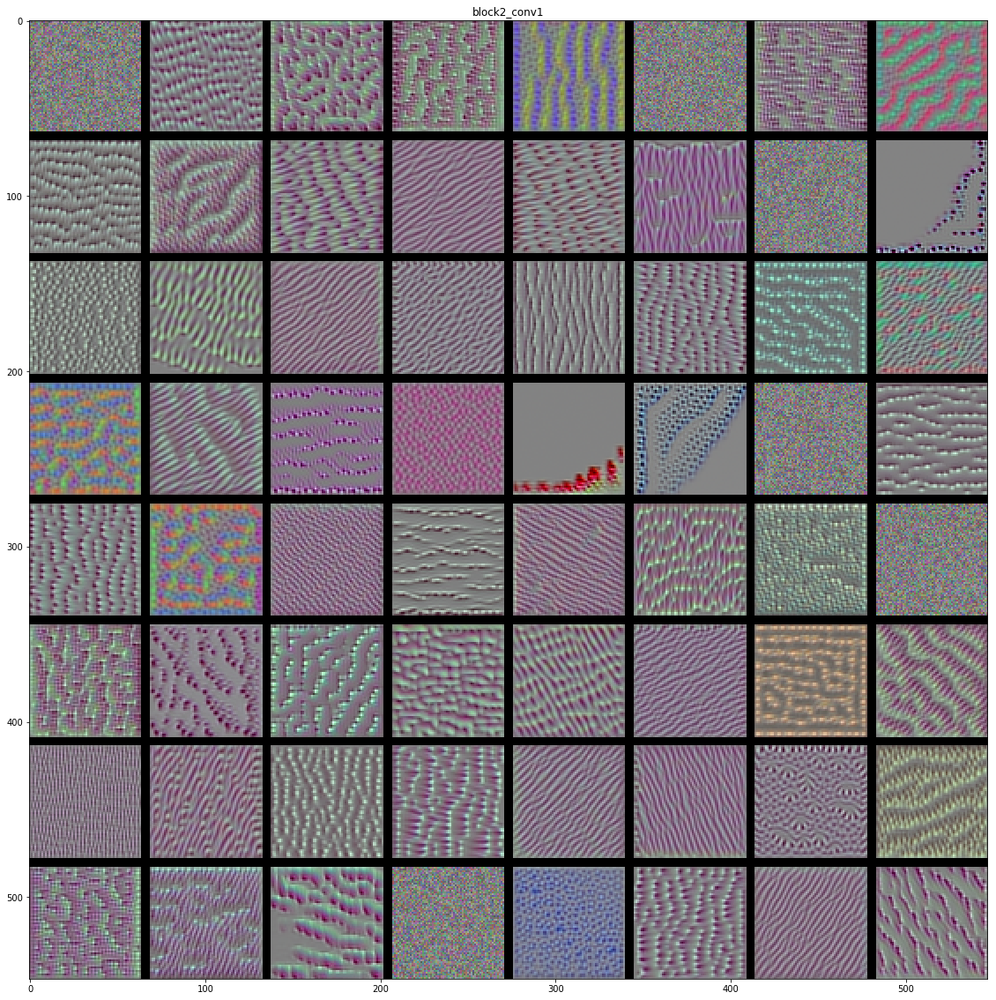

block2_conv2 0 1387.5618
block2_conv2 8 907.9728
block2_conv2 16 763.92065
block2_conv2 24 814.52893
block2_conv2 32 0.0
block2_conv2 40 1103.9218
block2_conv2 48 1569.731
block2_conv2 56 624.9281
block2_conv2 1 961.3095
block2_conv2 9 769.3298
block2_conv2 17 737.2119
block2_conv2 25 917.52
block2_conv2 33 1587.8834
block2_conv2 41 971.1592
block2_conv2 49 803.93634
block2_conv2 57 1325.396
block2_conv2 2 927.3689
block2_conv2 10 1808.6848
block2_conv2 18 938.82196
block2_conv2 26 818.4958
block2_conv2 34 694.67065
block2_conv2 42 1022.3005
block2_conv2 50 1301.7224
block2_conv2 58 811.719
block2_conv2 3 867.5837
block2_conv2 11 1670.8065
block2_conv2 19 865.77844
block2_conv2 27 1728.9268
block2_conv2 35 839.93744
block2_conv2 43 671.60986
block2_conv2 51 985.1432
block2_conv2 59 955.7263
block2_conv2 4 738.9969
block2_conv2 12 704.3316
block2_conv2 20 1643.529
block2_conv2 28 928.0617
block2_conv2 36 587.23303
block2_conv2 44 940.66174
block2_conv2 52 651.5825
block2_conv2 60 931.95

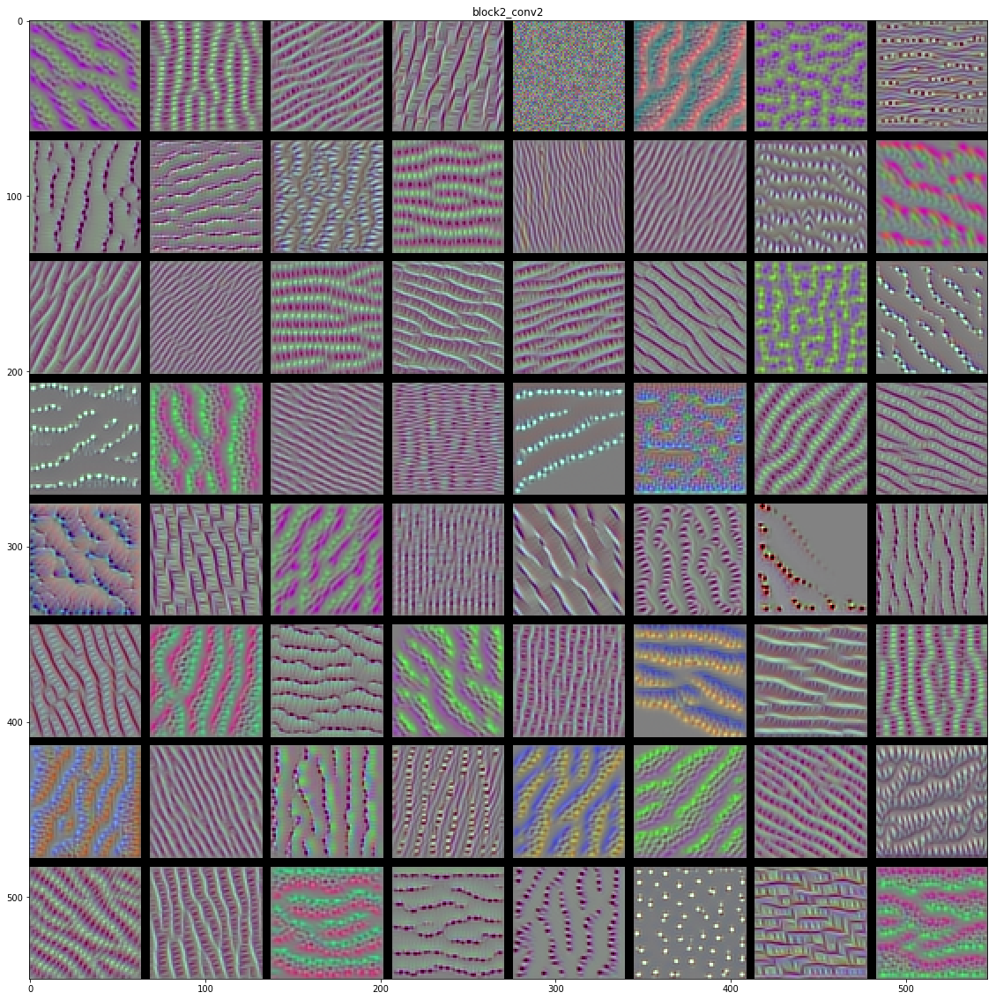

block3_conv1 0 1474.8636
block3_conv1 8 1770.0862
block3_conv1 16 1062.6562
block3_conv1 24 1187.312
block3_conv1 32 2787.7666
block3_conv1 40 2090.5403
block3_conv1 48 1960.3473
block3_conv1 56 1445.6692
block3_conv1 1 4620.0806
block3_conv1 9 1022.6583
block3_conv1 17 2295.6206
block3_conv1 25 1579.8572
block3_conv1 33 1339.2852
block3_conv1 41 1473.5282
block3_conv1 49 1579.4148
block3_conv1 57 1910.9834
block3_conv1 2 2223.6814
block3_conv1 10 2417.063
block3_conv1 18 754.7959
block3_conv1 26 3255.3113
block3_conv1 34 2823.1418
block3_conv1 42 1975.617
block3_conv1 50 556.8566
block3_conv1 58 2431.3838
block3_conv1 3 1261.736
block3_conv1 11 0.0
block3_conv1 19 0.0
block3_conv1 27 3906.288
block3_conv1 35 1327.5282
block3_conv1 43 1071.7876
block3_conv1 51 1308.8467
block3_conv1 59 4337.132
block3_conv1 4 1284.8656
block3_conv1 12 1096.9672
block3_conv1 20 1581.1299
block3_conv1 28 1691.8107
block3_conv1 36 2087.4377
block3_conv1 44 1907.0459
block3_conv1 52 1548.2908
block3_conv1 

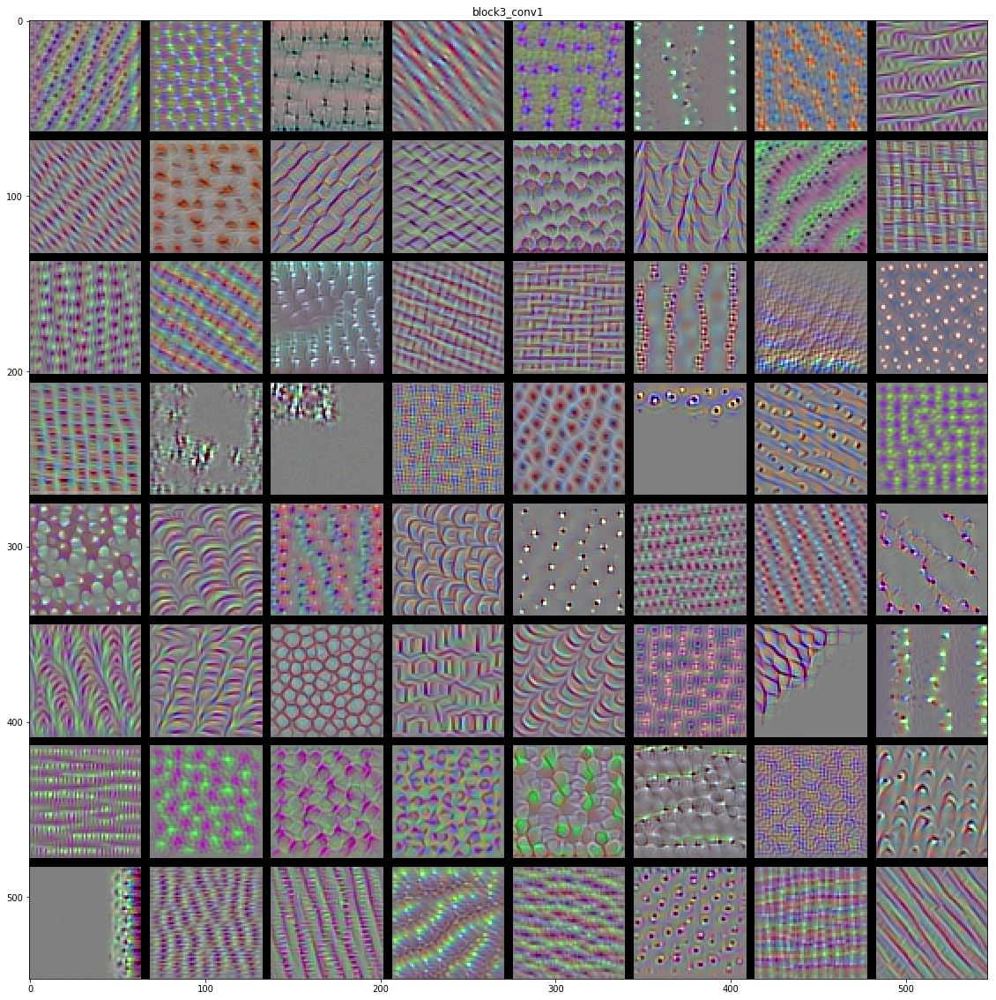

block3_conv2 0 1906.0618
block3_conv2 8 2264.3452
block3_conv2 16 1854.1443
block3_conv2 24 3020.0493
block3_conv2 32 2397.2712
block3_conv2 40 1806.7579
block3_conv2 48 2415.054
block3_conv2 56 1565.8047
block3_conv2 1 1870.1456
block3_conv2 9 1929.7743
block3_conv2 17 1750.0856
block3_conv2 25 1175.2588
block3_conv2 33 1807.748
block3_conv2 41 1989.5796
block3_conv2 49 2933.906
block3_conv2 57 2292.596
block3_conv2 2 2294.7627
block3_conv2 10 1990.5137
block3_conv2 18 1858.608
block3_conv2 26 2322.9268
block3_conv2 34 2021.8383
block3_conv2 42 2291.7654
block3_conv2 50 2121.1042
block3_conv2 58 2951.065
block3_conv2 3 2202.8015
block3_conv2 11 2010.0187
block3_conv2 19 1383.5404
block3_conv2 27 1667.1573
block3_conv2 35 2793.2896
block3_conv2 43 1793.1909
block3_conv2 51 3483.775
block3_conv2 59 1800.0181
block3_conv2 4 1368.3416
block3_conv2 12 2070.8232
block3_conv2 20 2340.0356
block3_conv2 28 2555.933
block3_conv2 36 1368.6814
block3_conv2 44 1693.7773
block3_conv2 52 1757.6765
b

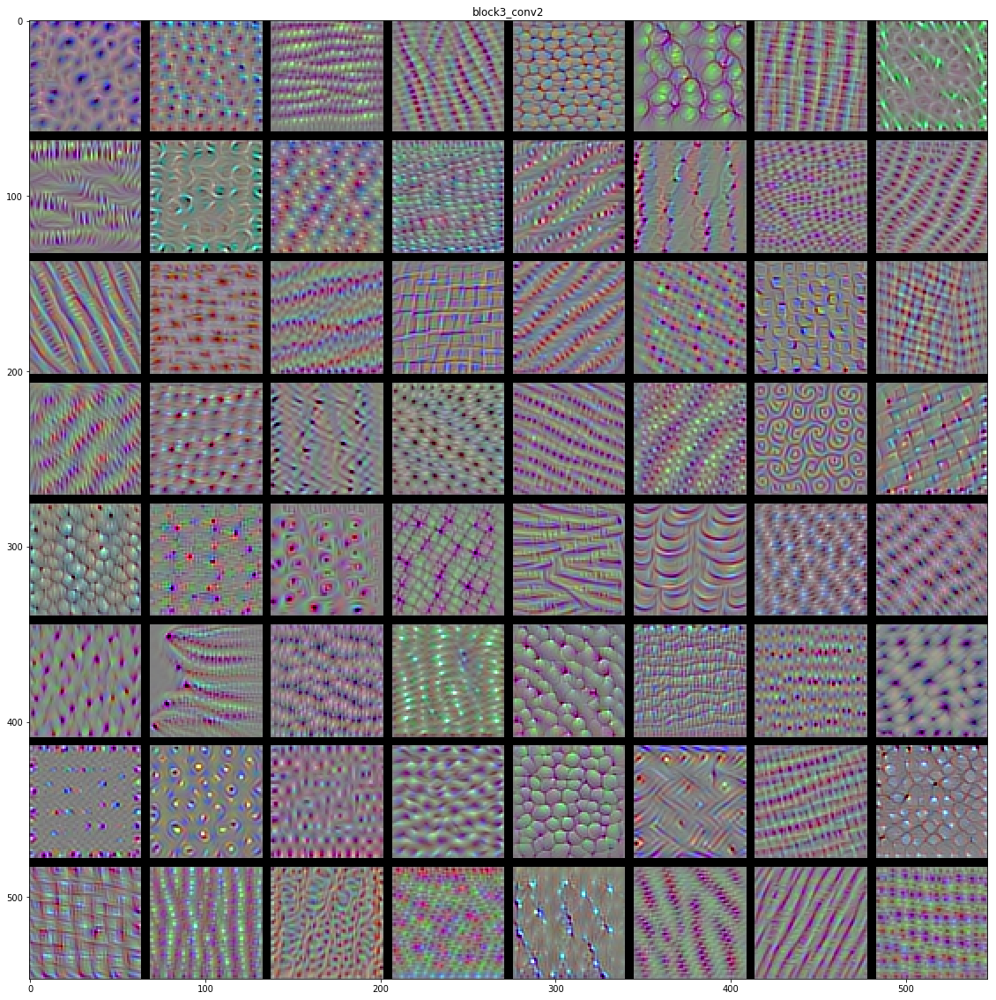

block3_conv3 0 6981.41
block3_conv3 8 5276.3213
block3_conv3 16 3866.7446
block3_conv3 24 1809.2554
block3_conv3 32 4156.1465
block3_conv3 40 5403.0205
block3_conv3 48 6278.719
block3_conv3 56 0.0
block3_conv3 1 3940.1333
block3_conv3 9 5194.3784
block3_conv3 17 3023.6484
block3_conv3 25 4543.8013
block3_conv3 33 3276.5527
block3_conv3 41 2889.982
block3_conv3 49 2710.6287
block3_conv3 57 4864.5303
block3_conv3 2 5015.645
block3_conv3 10 1608.188
block3_conv3 18 4499.3804
block3_conv3 26 2793.6587
block3_conv3 34 4222.9644
block3_conv3 42 3646.3706
block3_conv3 50 3950.9033
block3_conv3 58 3171.6248
block3_conv3 3 4950.4243
block3_conv3 11 2918.4297
block3_conv3 19 2942.5527
block3_conv3 27 3540.2239
block3_conv3 35 3672.2017
block3_conv3 43 3255.8003
block3_conv3 51 3700.5881
block3_conv3 59 4341.4214
block3_conv3 4 2942.7441
block3_conv3 12 7024.23
block3_conv3 20 3301.7458
block3_conv3 28 2808.715
block3_conv3 36 1892.8038
block3_conv3 44 3796.495
block3_conv3 52 4573.3853
block3_co

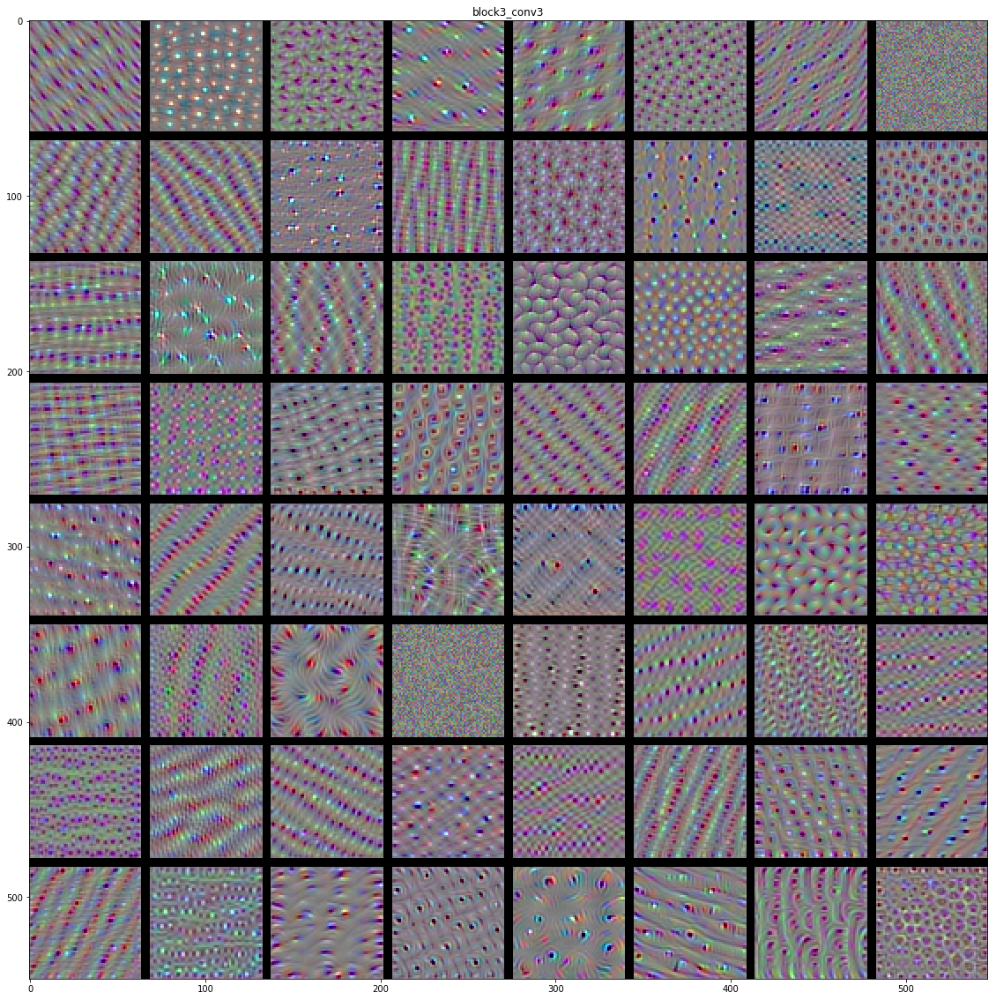

block3_conv4 0 14091.078
block3_conv4 8 5234.8784
block3_conv4 16 6684.5225
block3_conv4 24 5572.0913
block3_conv4 32 13766.517
block3_conv4 40 4686.1797
block3_conv4 48 6433.633
block3_conv4 56 7450.699
block3_conv4 1 7648.0312
block3_conv4 9 15295.009
block3_conv4 17 11135.518
block3_conv4 25 11608.246
block3_conv4 33 14598.914
block3_conv4 41 7132.441
block3_conv4 49 15443.466
block3_conv4 57 3761.4497
block3_conv4 2 6076.066
block3_conv4 10 3921.0588
block3_conv4 18 4601.393
block3_conv4 26 7400.0825
block3_conv4 34 300.95685
block3_conv4 42 11137.599
block3_conv4 50 6265.111
block3_conv4 58 9187.423
block3_conv4 3 7748.6987
block3_conv4 11 9123.966
block3_conv4 19 5878.1436
block3_conv4 27 8283.316
block3_conv4 35 5115.83
block3_conv4 43 4911.0737
block3_conv4 51 3775.6177
block3_conv4 59 7522.9116
block3_conv4 4 15197.605
block3_conv4 12 6476.507
block3_conv4 20 3046.4377
block3_conv4 28 8057.396
block3_conv4 36 3418.4043
block3_conv4 44 4627.0938
block3_conv4 52 7207.8516
block3

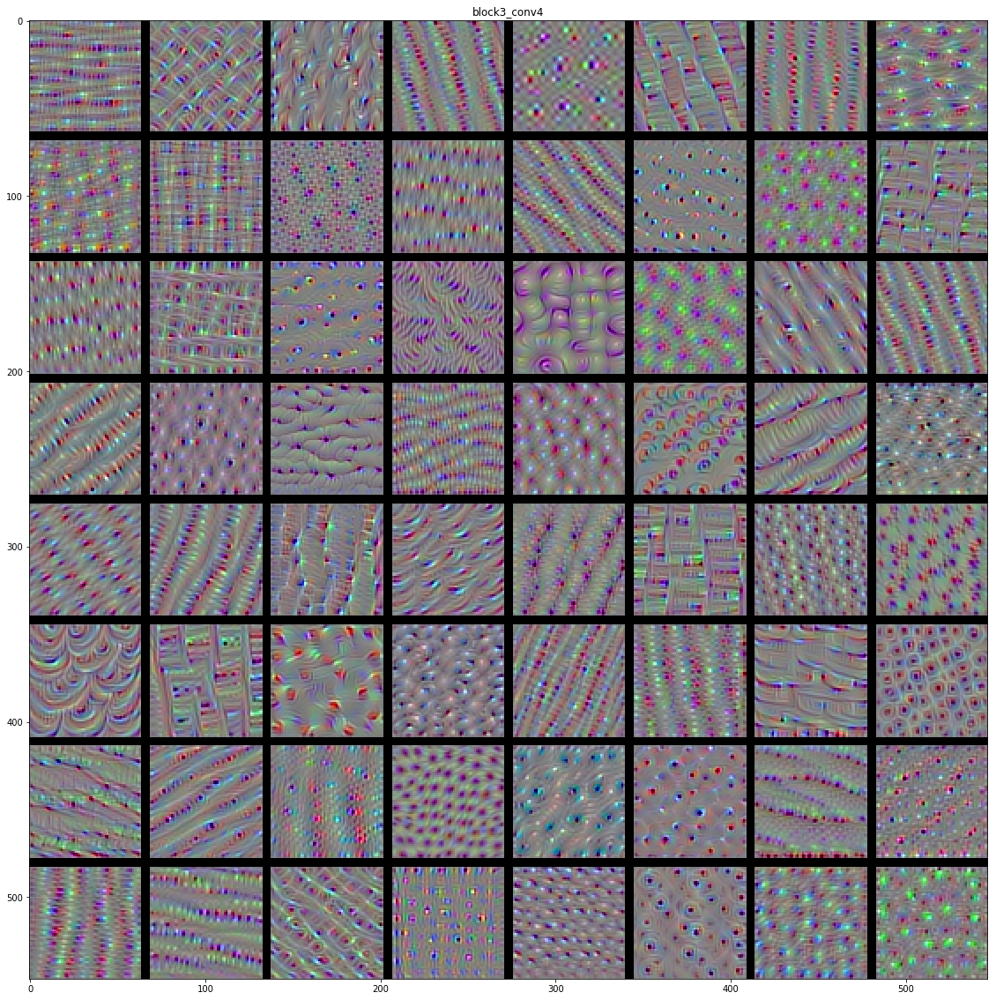

block4_conv1 0 10475.718
block4_conv1 8 8409.854
block4_conv1 16 0.0
block4_conv1 24 9993.508
block4_conv1 32 0.0
block4_conv1 40 0.0
block4_conv1 48 5147.3086
block4_conv1 56 8074.455
block4_conv1 1 5133.1797
block4_conv1 9 0.0
block4_conv1 17 17483.238
block4_conv1 25 12723.405
block4_conv1 33 10583.566
block4_conv1 41 9082.734
block4_conv1 49 11102.702
block4_conv1 57 9093.775
block4_conv1 2 6962.259
block4_conv1 10 11700.989
block4_conv1 18 10406.174
block4_conv1 26 6830.3506
block4_conv1 34 13852.178
block4_conv1 42 0.0
block4_conv1 50 10675.168
block4_conv1 58 10939.005
block4_conv1 3 5118.9824
block4_conv1 11 10406.252
block4_conv1 19 11264.198
block4_conv1 27 6760.5127
block4_conv1 35 7545.183
block4_conv1 43 11598.305
block4_conv1 51 3977.6575
block4_conv1 59 16920.74
block4_conv1 4 10494.41
block4_conv1 12 11265.785
block4_conv1 20 9185.812
block4_conv1 28 6451.304
block4_conv1 36 0.0
block4_conv1 44 11663.641
block4_conv1 52 8897.023
block4_conv1 60 6371.994
block4_conv1 5 9

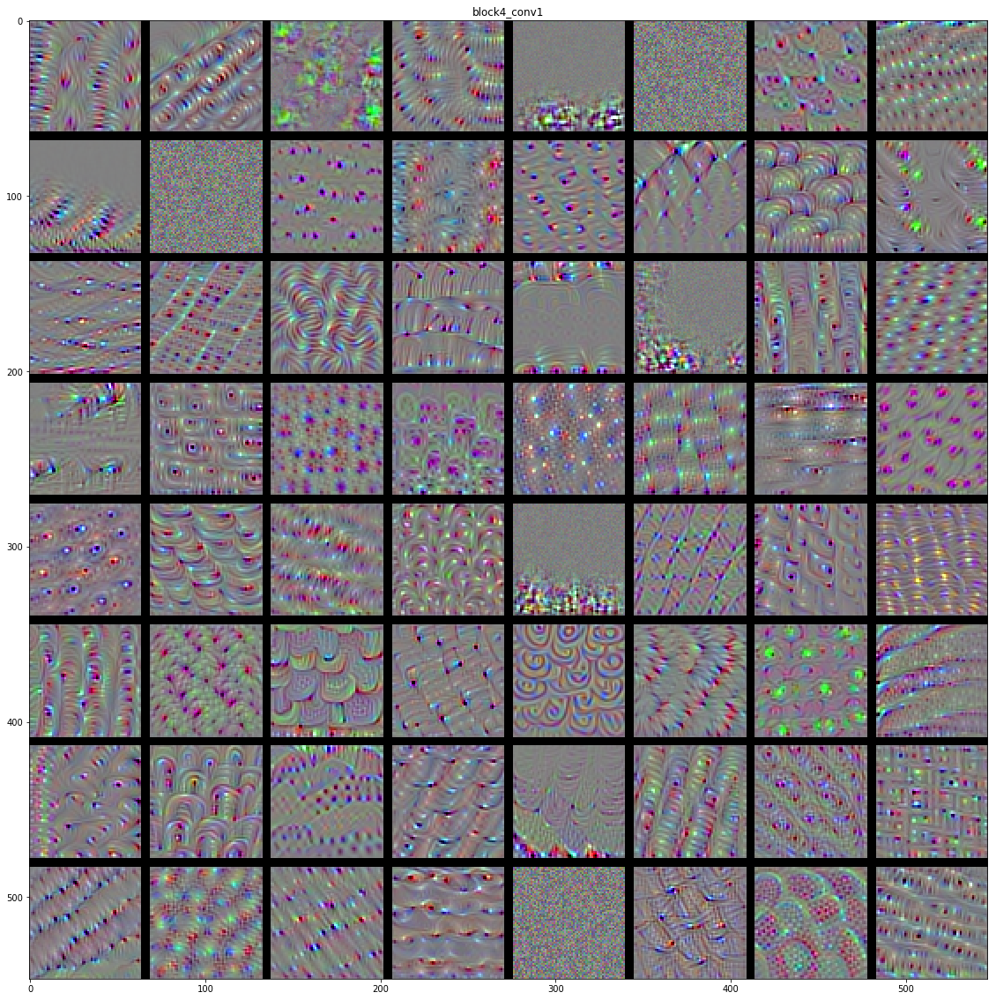

block4_conv2 0 7704.6426
block4_conv2 8 6444.9424
block4_conv2 16 0.0
block4_conv2 24 8556.543
block4_conv2 32 7011.741
block4_conv2 40 10592.961
block4_conv2 48 7836.4014
block4_conv2 56 0.0
block4_conv2 1 0.0
block4_conv2 9 0.0
block4_conv2 17 8316.252
block4_conv2 25 11344.301
block4_conv2 33 8950.059
block4_conv2 41 7659.6973
block4_conv2 49 11289.165
block4_conv2 57 8964.909
block4_conv2 2 8958.582
block4_conv2 10 8326.762
block4_conv2 18 0.0
block4_conv2 26 7687.546
block4_conv2 34 0.0
block4_conv2 42 10193.268
block4_conv2 50 0.0
block4_conv2 58 6853.537
block4_conv2 3 9342.828
block4_conv2 11 9751.13
block4_conv2 19 9894.02
block4_conv2 27 0.0
block4_conv2 35 8391.361
block4_conv2 43 7052.793
block4_conv2 51 0.0
block4_conv2 59 10760.717
block4_conv2 4 17613.344
block4_conv2 12 7845.172
block4_conv2 20 6140.13
block4_conv2 28 8648.057
block4_conv2 36 8133.041
block4_conv2 44 7700.839
block4_conv2 52 11210.852
block4_conv2 60 9313.528
block4_conv2 5 7106.3096
block4_conv2 13 119

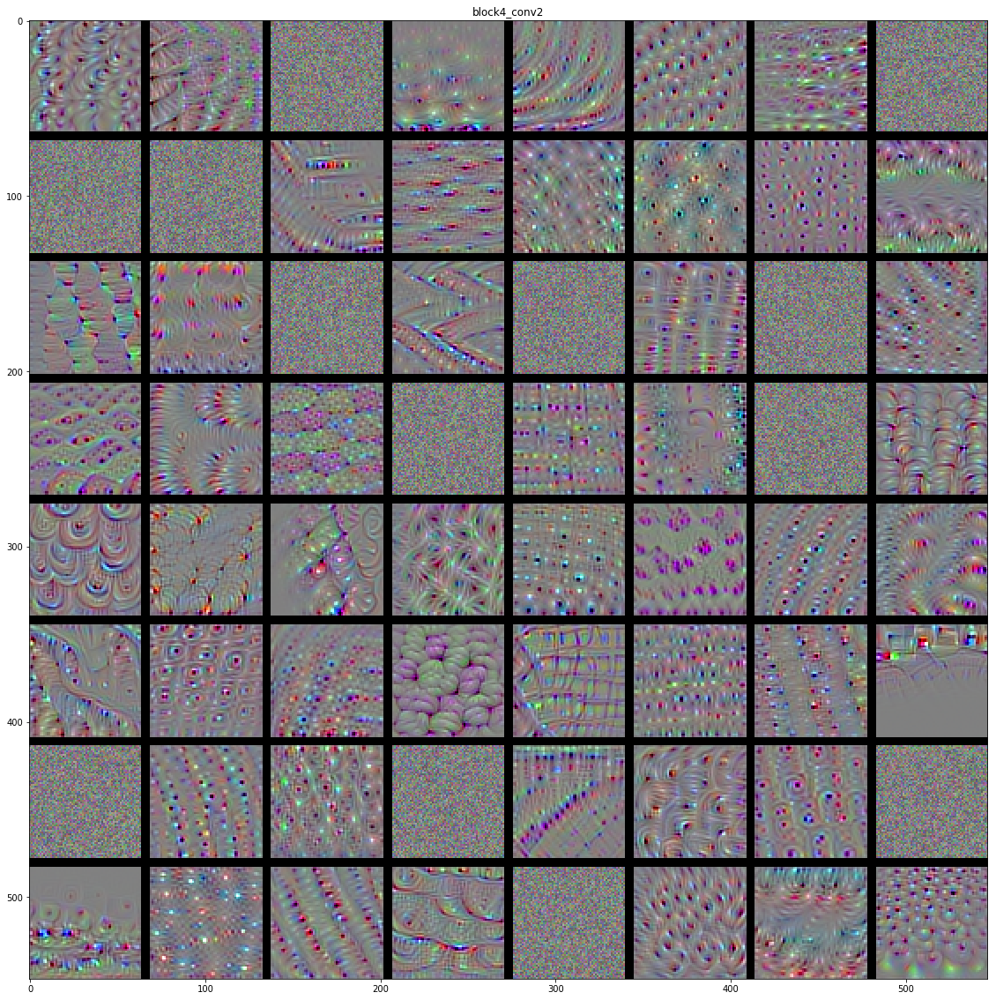

block4_conv3 0 0.0
block4_conv3 8 6200.092
block4_conv3 16 7142.0615
block4_conv3 24 3665.8206
block4_conv3 32 0.0
block4_conv3 40 8668.775
block4_conv3 48 4748.086
block4_conv3 56 8901.332
block4_conv3 1 8082.818
block4_conv3 9 8775.556
block4_conv3 17 7528.3115
block4_conv3 25 8142.3438
block4_conv3 33 6241.389
block4_conv3 41 4604.5767
block4_conv3 49 7075.3022
block4_conv3 57 7225.1357
block4_conv3 2 8919.6045
block4_conv3 10 8041.3003
block4_conv3 18 5449.714
block4_conv3 26 7145.212
block4_conv3 34 7291.5645
block4_conv3 42 5314.499
block4_conv3 50 9224.212
block4_conv3 58 0.0
block4_conv3 3 0.0
block4_conv3 11 11764.68
block4_conv3 19 10771.039
block4_conv3 27 10484.59
block4_conv3 35 7532.8545
block4_conv3 43 6009.0366
block4_conv3 51 0.0
block4_conv3 59 8712.535
block4_conv3 4 8473.607
block4_conv3 12 9792.16
block4_conv3 20 6015.639
block4_conv3 28 7658.3223
block4_conv3 36 6955.96
block4_conv3 44 9586.57
block4_conv3 52 7556.712
block4_conv3 60 10102.426
block4_conv3 5 7367.

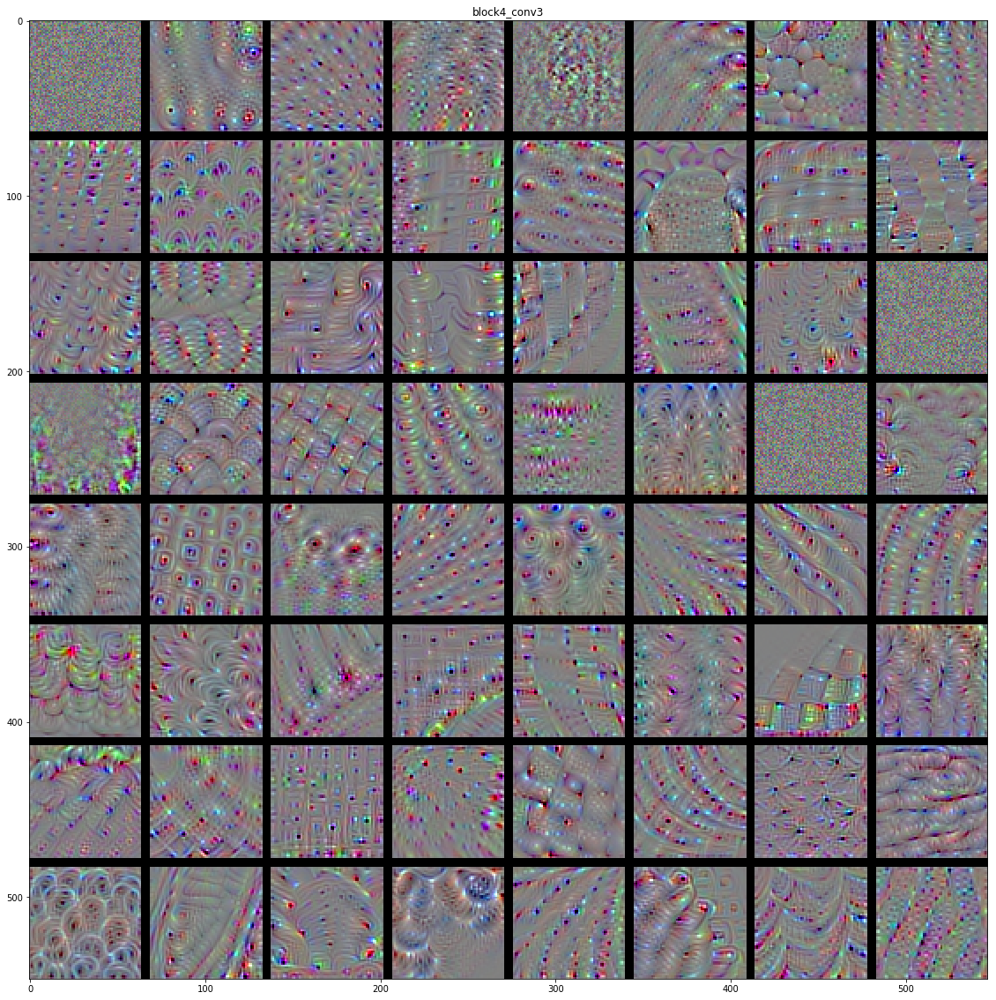

block4_conv4 0 4538.078
block4_conv4 8 4027.3103
block4_conv4 16 4012.1404
block4_conv4 24 0.0
block4_conv4 32 2682.4634
block4_conv4 40 0.0
block4_conv4 48 0.0
block4_conv4 56 3124.8164
block4_conv4 1 3228.0544
block4_conv4 9 5355.299
block4_conv4 17 3505.8032
block4_conv4 25 3811.4136
block4_conv4 33 0.0
block4_conv4 41 0.0
block4_conv4 49 3489.816
block4_conv4 57 1655.0979
block4_conv4 2 3600.5955
block4_conv4 10 3918.5586
block4_conv4 18 3335.2554
block4_conv4 26 4622.6523
block4_conv4 34 4689.9126
block4_conv4 42 3764.1848
block4_conv4 50 3538.712
block4_conv4 58 0.0
block4_conv4 3 0.0
block4_conv4 11 2842.989
block4_conv4 19 4515.55
block4_conv4 27 6653.9375
block4_conv4 35 5325.5728
block4_conv4 43 0.0
block4_conv4 51 2854.7664
block4_conv4 59 2329.0598
block4_conv4 4 0.0
block4_conv4 12 2186.4783
block4_conv4 20 3228.8774
block4_conv4 28 3170.0942
block4_conv4 36 0.0
block4_conv4 44 6289.081
block4_conv4 52 3892.0493
block4_conv4 60 2445.0374
block4_conv4 5 0.0
block4_conv4 13 

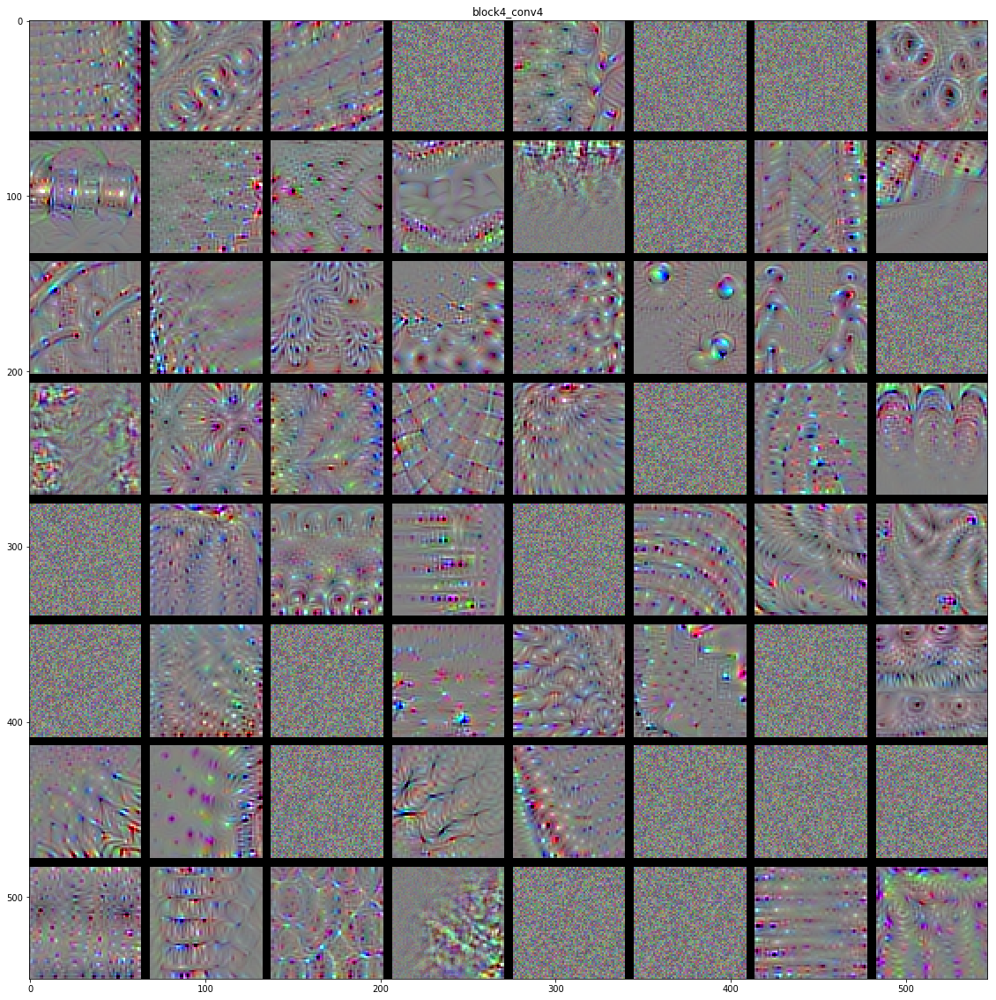

block5_conv1 0 2605.9507
block5_conv1 8 0.0
block5_conv1 16 4530.59
block5_conv1 24 0.0
block5_conv1 32 4225.509
block5_conv1 40 3863.2861
block5_conv1 48 8231.699
block5_conv1 56 0.0
block5_conv1 1 0.0
block5_conv1 9 3623.2637
block5_conv1 17 4792.3813
block5_conv1 25 3738.671
block5_conv1 33 3173.5454
block5_conv1 41 4711.7773
block5_conv1 49 0.0
block5_conv1 57 0.0
block5_conv1 2 3165.1182
block5_conv1 10 3295.1782
block5_conv1 18 4660.1113
block5_conv1 26 2345.2554
block5_conv1 34 0.0
block5_conv1 42 0.0
block5_conv1 50 0.0
block5_conv1 58 5081.1074
block5_conv1 3 4242.5464
block5_conv1 11 0.0
block5_conv1 19 3373.9185
block5_conv1 27 5439.2344
block5_conv1 35 4992.8184
block5_conv1 43 4621.4604
block5_conv1 51 5000.534
block5_conv1 59 4963.739
block5_conv1 4 2734.0398
block5_conv1 12 0.0
block5_conv1 20 0.0
block5_conv1 28 0.0
block5_conv1 36 1947.8737
block5_conv1 44 3889.675
block5_conv1 52 0.0
block5_conv1 60 4466.6606
block5_conv1 5 3475.9253
block5_conv1 13 4882.2407
block5_c

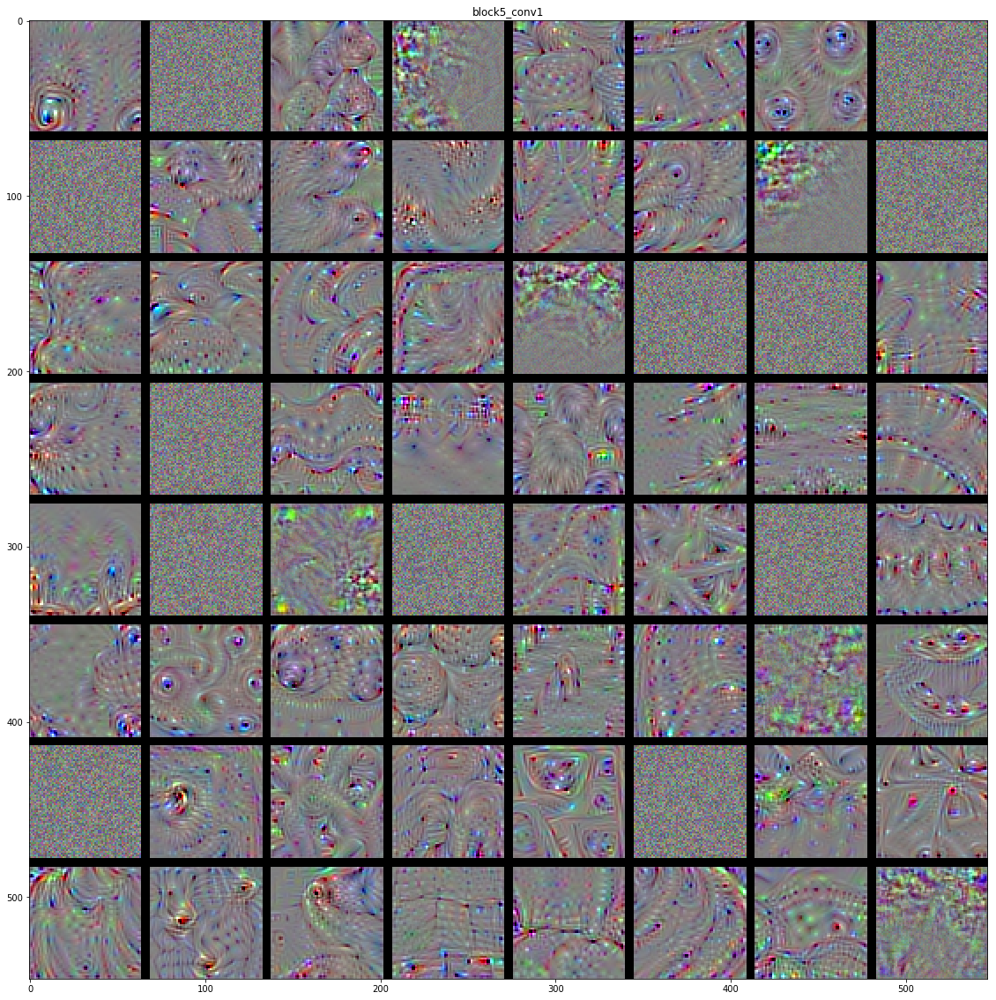

block5_conv2 0 0.0
block5_conv2 8 0.0
block5_conv2 16 2186.8713
block5_conv2 24 1849.4326
block5_conv2 32 0.0
block5_conv2 40 1962.126
block5_conv2 48 2932.911
block5_conv2 56 1637.4695
block5_conv2 1 0.0
block5_conv2 9 2115.9224
block5_conv2 17 1748.9165
block5_conv2 25 1390.1063
block5_conv2 33 0.0
block5_conv2 41 2553.2605
block5_conv2 49 1633.9089
block5_conv2 57 1726.4547
block5_conv2 2 1748.1497
block5_conv2 10 1476.4402
block5_conv2 18 836.37915
block5_conv2 26 0.0
block5_conv2 34 0.0
block5_conv2 42 0.0
block5_conv2 50 2215.9065
block5_conv2 58 1694.2048
block5_conv2 3 1930.6738
block5_conv2 11 1910.7009
block5_conv2 19 0.0
block5_conv2 27 0.0
block5_conv2 35 1802.8469
block5_conv2 43 1667.5061
block5_conv2 51 0.0
block5_conv2 59 0.0
block5_conv2 4 0.0
block5_conv2 12 1557.773
block5_conv2 20 1503.3086
block5_conv2 28 0.0
block5_conv2 36 0.0
block5_conv2 44 1965.5916
block5_conv2 52 1537.1926
block5_conv2 60 0.0
block5_conv2 5 3195.0928
block5_conv2 13 0.0
block5_conv2 21 2402.

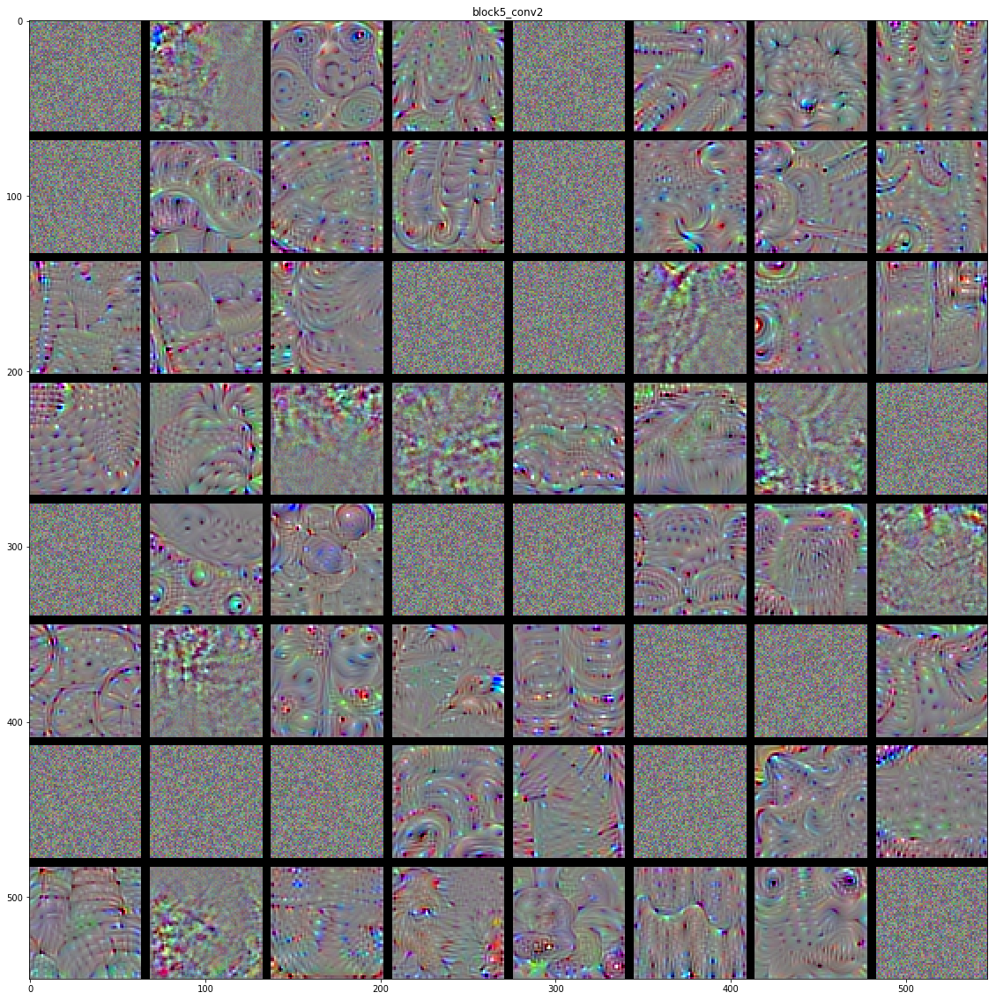

block5_conv3 0 0.0
block5_conv3 8 742.61774
block5_conv3 16 1273.379
block5_conv3 24 1214.6069
block5_conv3 32 755.59784
block5_conv3 40 813.6791
block5_conv3 48 0.0
block5_conv3 56 0.0
block5_conv3 1 0.0
block5_conv3 9 1143.1986
block5_conv3 17 0.0
block5_conv3 25 895.22327
block5_conv3 33 1072.8064
block5_conv3 41 1497.7166
block5_conv3 49 0.0
block5_conv3 57 865.9186
block5_conv3 2 753.5326
block5_conv3 10 0.0
block5_conv3 18 0.0
block5_conv3 26 0.0
block5_conv3 34 1063.9346
block5_conv3 42 1134.5391
block5_conv3 50 1504.2627
block5_conv3 58 839.00244
block5_conv3 3 837.4665
block5_conv3 11 0.0
block5_conv3 19 0.0
block5_conv3 27 1142.8578
block5_conv3 35 1064.7263
block5_conv3 43 987.21106
block5_conv3 51 0.0
block5_conv3 59 873.1044
block5_conv3 4 983.0285
block5_conv3 12 705.8996
block5_conv3 20 0.0
block5_conv3 28 817.15967
block5_conv3 36 0.0
block5_conv3 44 0.0
block5_conv3 52 1251.3721
block5_conv3 60 0.0
block5_conv3 5 0.0
block5_conv3 13 768.4205
block5_conv3 21 0.0
block5_

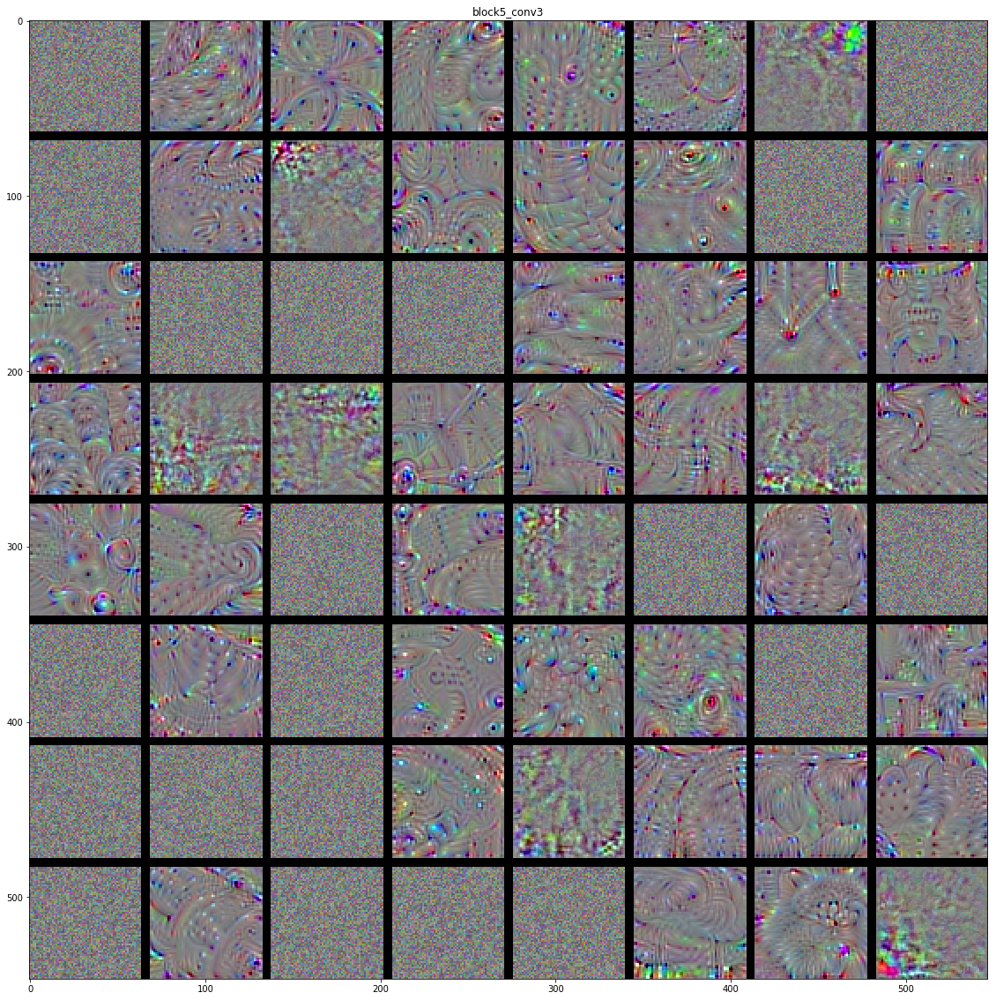

block5_conv4 0 471.77902
block5_conv4 8 0.0
block5_conv4 16 0.0
block5_conv4 24 0.0
block5_conv4 32 0.0
block5_conv4 40 254.51695
block5_conv4 48 0.0
block5_conv4 56 0.0
block5_conv4 1 0.0
block5_conv4 9 0.0
block5_conv4 17 0.0
block5_conv4 25 0.0
block5_conv4 33 0.0
block5_conv4 41 0.0
block5_conv4 49 917.1222
block5_conv4 57 0.0
block5_conv4 2 0.0
block5_conv4 10 0.0
block5_conv4 18 0.0
block5_conv4 26 0.0
block5_conv4 34 0.0
block5_conv4 42 274.1858
block5_conv4 50 0.0
block5_conv4 58 584.19666
block5_conv4 3 0.0
block5_conv4 11 0.0
block5_conv4 19 0.0
block5_conv4 27 499.9967
block5_conv4 35 0.0
block5_conv4 43 501.8748
block5_conv4 51 0.0
block5_conv4 59 0.0
block5_conv4 4 0.0
block5_conv4 12 0.0
block5_conv4 20 0.0
block5_conv4 28 328.266
block5_conv4 36 411.6574
block5_conv4 44 0.0
block5_conv4 52 344.3319
block5_conv4 60 0.0
block5_conv4 5 0.0
block5_conv4 13 0.0
block5_conv4 21 0.0
block5_conv4 29 0.0
block5_conv4 37 0.0
block5_conv4 45 0.0
block5_conv4 53 0.0
block5_conv4 61 

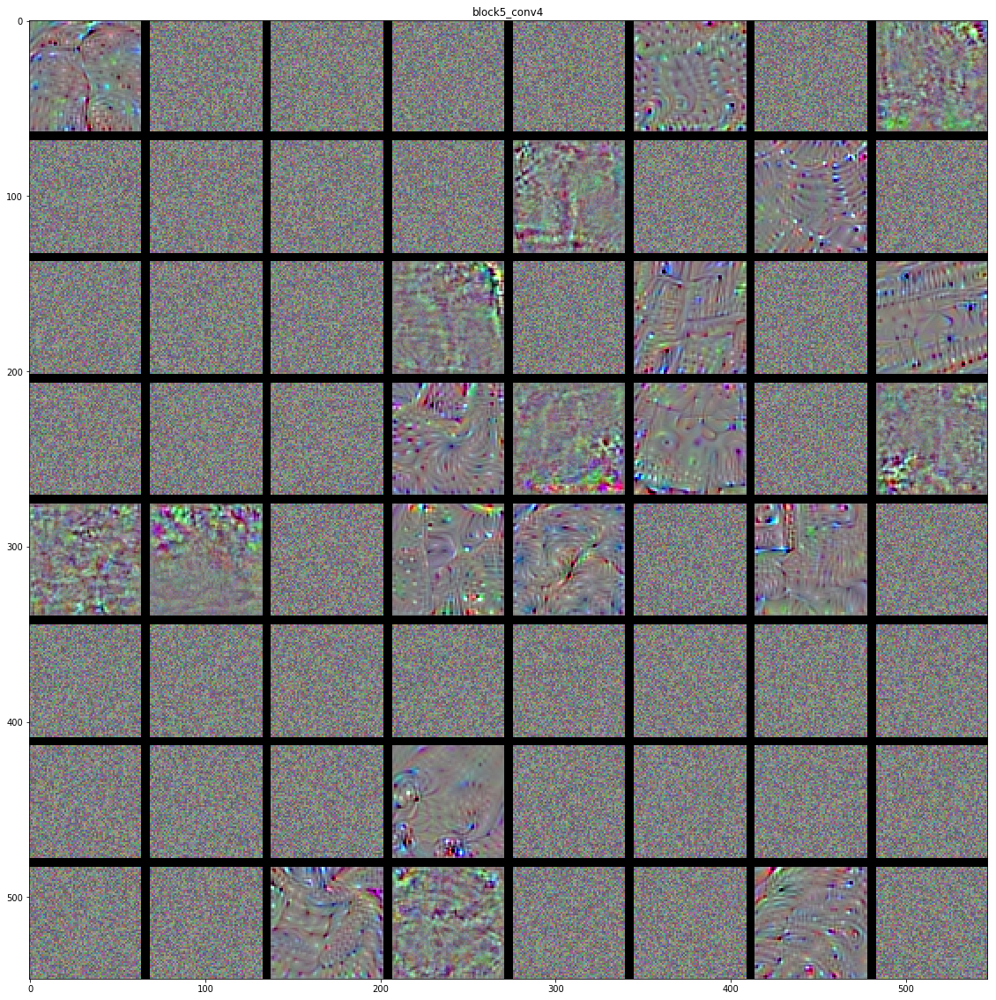

In [0]:
#from tqdm import tqdm
#make list consisting of all the layers names of transferred VGG19 model
layer_names = ['block1_conv1', 'block1_conv2', 
               'block2_conv1', 'block2_conv2', 
               'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_conv4',
               'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_conv4',
               'block5_conv1', 'block5_conv2', 'block5_conv3','block5_conv4']
#looping through each layer
for layer_name in layer_names: 
    size = 64
    margin = 5
    # creating blank image that stores the results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))
    for i in range(8):  # iterate over the rows of grid
        for j in range(8):  # iterate over the columns of grid
            # Generate the pattern for filter of size i + (j * 8) for layer
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)
            # Putting result in the square of the grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display grid with the result
    plt.figure(figsize=(20, 20))
    plt.title(layer_name)
    plt.imshow(results)
    plt.show()